link Gravação >>> https://cefetrjbr-my.sharepoint.com/:v:/g/personal/07851233771_cefet-rj_br/EWAzv9kkq1FNpD1Bxs1KrCsBxaJugwPltMLAWw0iKSDodQ?referrer=Teams.TEAMS-ELECTRON&referrerScenario=MeetingChicletGetLink.view.view

# 1 Engenharia de Features

# Importando os pacotes

In [3]:
import pandas as pd # Utilização de datasets
import matplotlib.pyplot as plt # Visualização dos gráficos
import numpy as np # Utilização de analise de dados
from sklearn.preprocessing import StandardScaler # Normalização dados
import seaborn as sns
# Modelos e Analises
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

In [47]:
# Importando o Dataset e atribuindo as variáveis, conforme a Tabela 1: Esquema do conjunto de dados com histórico de clientes.
# O conjunto de dados a ser utilizado para treinamento(treino) e testes(testes).

In [48]:
column_names = ['Esct','Ndep','Renda', 'Tipor', 'Vbem', 'Nparc', 'Vparc', 'Tel', 'Idade', 'Resms', 'Entrada', 'Classe']

df_treino = pd.read_table('https://raw.githubusercontent.com/MLRG-CEFET-RJ/cic1205/main/data/credtrain.txt', names=column_names, header=None)

df_teste = pd.read_table('https://raw.githubusercontent.com/MLRG-CEFET-RJ/cic1205/main/data/credtest.txt', names=column_names, header=None)


In [49]:
# Validando o tamanho dos dataset's
df_treino.shape, df_teste.shape

((1500, 12), (577, 12))

In [50]:
df_treino.head(4)

,Esct,Ndep,Renda,Tipor,Vbem,Nparc,Vparc,Tel,Idade,Resms,Entrada,Classe
0,1,0,360,0,313,9,52,0,25,48,0,1
1,0,0,350,1,468,10,65,0,33,6,0,1
2,0,0,1100,0,829,9,125,0,56,48,0,1
3,0,0,3000,0,552,12,76,1,31,60,0,1


In [51]:
df_teste.head(4)

,Esct,Ndep,Renda,Tipor,Vbem,Nparc,Vparc,Tel,Idade,Resms,Entrada,Classe
0,0,2,500,1,618,10,85,0,36,6,0,0
1,1,0,813,0,552,4,119,0,43,48,119,1
2,3,0,350,0,488,12,66,0,43,0,0,1
3,1,0,1530,0,381,1,398,0,28,48,0,1


In [52]:
df_treino.isnull().sum().sum() #checando a existência de valores nulos
df_teste.isnull().sum().sum()

0

#Utilizando novas técnicas para transformar variáveis categóricas.

No dataset existem variáveis categóricas, apontado pelo enunciado do exercício: Esct (Estado Civil), Ndep (Número de dependentes) e Tipor(Tipo de residência) são variáveis categóricas. A variável Esct não tem uma ordem específica, ou seja, 2 não é o dobro de 1 no estado civil por exemplo. Isso pode ser problemático em alguns modelos, trazendo problemas no seu treinamento. Nesta parte, iremos aplicar novas técnicas de transformações destas variáveis.

A escolha da técnica de codificação deve ser baseada nas características do seu conjunto de dados e nas suposições subjacentes ao modelo que você está utilizando. De forma empírica foram testadas algumas opções diferentes para avaliar o desempenho do modelo para determinar qual técnica de codificação funciona melhor para o seu caso específico.


### Count Encoder 

É útil quando a frequência das categorias é informativa. O Count Encoder substitui cada categoria pelo número de vezes que ela aparece no conjunto de dados. 

In [53]:
import category_encoders as ce

# Selecione as variáveis categóricas
variaveis_categoricas = ['Esct']

# Crie o HashingEncoder com base no conjunto de treinamento
encoder = ce.CountEncoder(cols=['Esct'])

# Ajuste e transforme os dados de treinamento
df_treino_encoded_CE = encoder.fit_transform(df_treino)

# Transforme os dados de teste usando as mesmas transformações
df_teste_encoded_CE = encoder.transform(df_teste)


In [54]:
df_treino_encoded_CE.head(5)

,Esct,Ndep,Renda,Tipor,Vbem,Nparc,Vparc,Tel,Idade,Resms,Entrada,Classe
0,601,0,360,0,313,9,52,0,25,48,0,1
1,834,0,350,1,468,10,65,0,33,6,0,1
2,834,0,1100,0,829,9,125,0,56,48,0,1
3,834,0,3000,0,552,12,76,1,31,60,0,1
4,601,0,1000,0,809,12,111,0,24,7,0,1


In [55]:
df_teste_encoded_CE.head(5)

,Esct,Ndep,Renda,Tipor,Vbem,Nparc,Vparc,Tel,Idade,Resms,Entrada,Classe
0,834,2,500,1,618,10,85,0,36,6,0,0
1,601,0,813,0,552,4,119,0,43,48,119,1
2,37,0,350,0,488,12,66,0,43,0,0,1
3,601,0,1530,0,381,1,398,0,28,48,0,1
4,834,0,688,1,396,10,60,0,49,72,0,1


### Hashing Encoder

O Hashing Encoder mapeia as categorias para valores hash, reduzindo a dimensionalidade sem impor uma ordem específica.

In [56]:
import category_encoders as ce

# Selecione as variáveis categóricas
variaveis_categoricas = ['Esct']

# Crie o HashingEncoder com base no conjunto de treinamento
encoder = ce.HashingEncoder(cols=['Esct'], n_components=4)

# Ajuste e transforme os dados de treinamento
df_treino_encoded_HE = encoder.fit_transform(df_treino)

# Transforme os dados de teste usando as mesmas transformações
df_teste_encoded_HE = encoder.transform(df_teste)

In [57]:
df_treino_encoded_HE.head(5)

,col_0,col_1,col_2,col_3,Ndep,Renda,Tipor,Vbem,Nparc,Vparc,Tel,Idade,Resms,Entrada,Classe
0,0,0,0,1,0,360,0,313,9,52,0,25,48,0,1
1,0,0,1,0,0,350,1,468,10,65,0,33,6,0,1
2,0,0,1,0,0,1100,0,829,9,125,0,56,48,0,1
3,0,0,1,0,0,3000,0,552,12,76,1,31,60,0,1
4,0,0,0,1,0,1000,0,809,12,111,0,24,7,0,1


In [58]:
df_teste_encoded_HE.head(5)

,col_0,col_1,col_2,col_3,Ndep,Renda,Tipor,Vbem,Nparc,Vparc,Tel,Idade,Resms,Entrada,Classe
0,0,0,1,0,2,500,1,618,10,85,0,36,6,0,0
1,0,0,0,1,0,813,0,552,4,119,0,43,48,119,1
2,0,0,0,1,0,350,0,488,12,66,0,43,0,0,1
3,0,0,0,1,0,1530,0,381,1,398,0,28,48,0,1
4,0,0,1,0,0,688,1,396,10,60,0,49,72,0,1


### Trabalho 1

In [59]:
df_treino = pd.get_dummies(data=df_treino, prefix="Esct", columns=["Esct"], drop_first=True)

df_teste = pd.get_dummies(data=df_teste, prefix="Esct", columns=["Esct"], drop_first=True)

In [60]:
df_treino.head(5)

,Ndep,Renda,Tipor,Vbem,Nparc,Vparc,Tel,Idade,Resms,Entrada,Classe,Esct_1,Esct_2,Esct_3
0,0,360,0,313,9,52,0,25,48,0,1,True,False,False
1,0,350,1,468,10,65,0,33,6,0,1,False,False,False
2,0,1100,0,829,9,125,0,56,48,0,1,False,False,False
3,0,3000,0,552,12,76,1,31,60,0,1,False,False,False
4,0,1000,0,809,12,111,0,24,7,0,1,True,False,False


In [61]:
df_teste.head(5)

,Ndep,Renda,Tipor,Vbem,Nparc,Vparc,Tel,Idade,Resms,Entrada,Classe,Esct_1,Esct_2,Esct_3
0,2,500,1,618,10,85,0,36,6,0,0,False,False,False
1,0,813,0,552,4,119,0,43,48,119,1,True,False,False
2,0,350,0,488,12,66,0,43,0,0,1,False,False,True
3,0,1530,0,381,1,398,0,28,48,0,1,True,False,False
4,0,688,1,396,10,60,0,49,72,0,1,False,False,False


### Ajustando os conjuntos de treinamento e teste.

In [62]:
# Trabalho 1

X_treino = df_treino.drop('Classe', axis=1)
X_treino = np.array(X_treino).astype(float)
y_treino = df_treino['Classe']

X_teste = df_teste.drop('Classe', axis=1)
X_teste = np.array(X_teste).astype(float)
y_teste = df_teste['Classe']

#Count Encoder
X_treinoCE = df_treino.drop('Classe', axis=1)
X_treinoCE = np.array(X_treinoCE).astype(float)
y_treinoCE = df_treino['Classe']

X_testeCE = df_teste.drop('Classe', axis=1)
X_testeCE = np.array(X_testeCE).astype(float)
y_testeCE = df_teste['Classe']

# Hashing Encoder
X_treinoHE = df_treino_encoded_HE.drop('Classe', axis=1)
X_treinoHE = np.array(X_treinoHE).astype(float)
y_treinoHE = df_treino_encoded_HE['Classe']

X_testeHE = df_teste_encoded_HE.drop('Classe', axis=1)
X_testeHE = np.array(X_testeHE).astype(float)
y_testeHE = df_teste_encoded_HE['Classe']

In [63]:
#Normalização

norm = StandardScaler()

X_treino = norm.fit_transform(X_treino)
X_teste = norm.transform(X_teste)

X_treinoCE = norm.fit_transform(X_treinoCE)
X_testeCE = norm.transform(X_testeCE)

X_treinoHE = norm.fit_transform(X_treinoHE)
X_testeHE = norm.transform(X_testeHE)

print(X_treino.shape, X_teste.shape, y_treino.shape, y_teste.shape, X_treinoCE.shape, X_testeCE.shape, y_treinoCE.shape, y_testeCE.shape, X_treinoHE.shape, X_testeHE.shape, y_treinoHE.shape, y_testeHE.shape)

(1500, 13) (577, 13) (1500,) (577,) (1500, 13) (577, 13) (1500,) (577,) (1500, 14) (577, 14) (1500,) (577,)


### Criando e treinando os modelos 

### Vamos utilizar o modelo Floresta Aleatória.

In [64]:
# Trabalho 1 
FloAle_T1 = RandomForestClassifier()
FloAle_T1.fit(X_treino, y_treino)

# Count Encoder
FloAle_CE = RandomForestClassifier()
FloAle_CE.fit(X_treinoCE, y_treinoCE)

# Hashing Encoder
FloAle_HE = RandomForestClassifier()
FloAle_HE.fit(X_treinoHE, y_treinoHE)


RandomForestClassifier()

### Previsões no conjunto de testes

In [71]:
y_pred_FloAle_T1 = FloAle_T1.predict(X_teste)

# Avaliação dos modelos
accuracy = accuracy_score(y_teste, y_pred_FloAle_T1)
confusion = confusion_matrix(y_teste, y_pred_FloAle_T1)
classification_rep = classification_report(y_teste, y_pred_FloAle_T1)

print(f"Accuracy: {accuracy * 100:.2f}%")
print("Matrix Confusão:\n", confusion)
print("Floresta Aleatória Trabalho 1:\n", classification_rep)

Accuracy: 89.95%
Matrix Confusão:
 [[296  10]
 [ 48 223]]
Floresta Aleatória Trabalho 1:
               precision    recall  f1-score   support

           0       0.86      0.97      0.91       306
           1       0.96      0.82      0.88       271

    accuracy                           0.90       577
   macro avg       0.91      0.90      0.90       577
weighted avg       0.91      0.90      0.90       577



In [72]:
y_pred_FloAle_CE = FloAle_CE.predict(X_testeCE)

# Avaliação dos modelos
accuracy = accuracy_score(y_testeCE, y_pred_FloAle_CE)
confusion = confusion_matrix(y_testeCE, y_pred_FloAle_CE)
classification_rep = classification_report(y_testeCE, y_pred_FloAle_CE)

print(f"Accuracy: {accuracy * 100:.2f}%")
print("Matrix Confusão:\n", confusion)
print("Floresta Aleatória Count Encoder:\n", classification_rep)

Accuracy: 89.77%
Matrix Confusão:
 [[292  14]
 [ 45 226]]
Floresta Aleatória Count Encoder:
               precision    recall  f1-score   support

           0       0.87      0.95      0.91       306
           1       0.94      0.83      0.88       271

    accuracy                           0.90       577
   macro avg       0.90      0.89      0.90       577
weighted avg       0.90      0.90      0.90       577



In [73]:
y_pred_FloAle_HE = FloAle_HE.predict(X_testeHE)

# Avaliação dos modelos
accuracy = accuracy_score(y_testeHE, y_pred_FloAle_HE)
confusion = confusion_matrix(y_testeHE, y_pred_FloAle_HE)
classification_rep = classification_report(y_testeHE, y_pred_FloAle_HE)

print(f"Accuracy: {accuracy * 100:.2f}%")
print("Matrix Confusão:\n", confusion)
print("Floresta Aleatória Hashing Encoder:\n", classification_rep)

Accuracy: 89.43%
Matrix Confusão:
 [[293  13]
 [ 48 223]]
Floresta Aleatória Hashing Encoder:
               precision    recall  f1-score   support

           0       0.86      0.96      0.91       306
           1       0.94      0.82      0.88       271

    accuracy                           0.89       577
   macro avg       0.90      0.89      0.89       577
weighted avg       0.90      0.89      0.89       577



### Após às aplicações de novas técnicas para codificação de variáveis categóricas, Count Encoder e Hashing Encoder, não foram observados diferenças significativas aplicada em modelos de Floresta Aleatória.

# 2 Validação Cruzada

In [23]:
import pickle
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import RandomizedSearchCV
from sklearn.metrics import accuracy_score
from sklearn.metrics import f1_score
from sklearn.model_selection import train_test_split
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

### A602

In [24]:
# Importando o Dataset
file = open('A602.pickle' , 'rb')
(X_train , y_train , X_val , y_val , X_test , y_test) = pickle.load(file)
print(f"Shapes: ", X_train.shape , X_val.shape , X_test.shape, y_train.shape , y_val.shape , y_test.shape)

Shapes:  (10178, 24) (2565, 24) (765, 24) (10178, 1) (2565, 1) (765, 1)


In [25]:
#Substituindo todos os valores diferentes de zero por 1

y_train[y_train != 0] = 1
y_val[y_val != 0] = 1
y_test[y_test != 0] = 1

# Salve as variáveis
with open('A602_substituido.pickle', 'wb') as file:
  pickle.dump((y_train, y_val, y_test), file)

In [26]:
print(f"Shapes: ", y_train.shape , y_val.shape , y_test.shape)

Shapes:  (10178, 1) (2565, 1) (765, 1)


### Concatenando os dados de treino com dados de validação

In [19]:
X_train_combined = np.concatenate((X_train, X_val), axis=0)
y_train_combined = np.concatenate((y_train, y_val), axis=0)

In [20]:
print("X_train_combined:", X_train_combined.shape)
print("y_train_combined:", y_train_combined.shape)

X_train_combined: (12743, 24)
y_train_combined: (12743, 1)


### Modelo Base Trabalho 1

In [21]:
Modelo_Base = DecisionTreeClassifier()
Modelo_Base.fit(X_train_combined, y_train_combined)

DecisionTreeClassifier()

In [22]:
y_pred_base = Modelo_Base.predict(X_test)

# Exibir métricas para o modelo padrão
print("Métricas para o modelo padrão (DecisionTreeClassifier):")
print("Acurácia:", accuracy_score(y_test, y_pred_base))

Métricas para o modelo padrão (DecisionTreeClassifier):
Acurácia: 0.7908496732026143


### Randon Search com  StratifiedKFold

#### O Random Search seleciona combinações aleatórias de valores de hiperparâmetros (dentro de intervalos predefinidos para cada hiperparâmetro) para treinar e avaliar os modelos candidatos. Em vez de testar todas as combinações possíveis de valores, a busca aleatória realiza um número pré-definido de iterações, testando uma combinação aleatória de hiperparâmetros em cada iteração. Neste exemplo, usaremos 100 iterações e um CV = 5 O parâmetro indica o número de dobras (folds) utilizadas na validação cruzada.

#### Utilizando StratfiedKFold = 5. O parâmetro n_splits no StratifiedKFold define o número de dobras (folds) que serão criadas durante a validação cruzada estratificada. Cada fold é uma divisão do conjunto de dados em partes para treino e teste. O número total de divisões é igual a n_splits.

In [23]:
from sklearn.model_selection import RandomizedSearchCV, StratifiedKFold
from sklearn.tree import DecisionTreeClassifier
from scipy.stats import randint

# Defina a árvore de decisão
dt_classifier = DecisionTreeClassifier()

# Defina o espaço de busca de hiperparâmetros
param_dist = {
  'criterion': ['gini', 'entropy'],
    'splitter': ['best', 'random'],
    'max_depth': [None, 10, 20, 30, 40, 50],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'max_features': [None, 'sqrt', 'log2', 0.2, 0.5, 0.7, 0.8, 0.9]
}

# Defina o método de validação cruzada estratificada
stratified_cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# Crie o objeto RandomizedSearchCV
random_search = RandomizedSearchCV(
    dt_classifier,
    param_distributions=param_dist,
    n_iter=100,  # Número de iterações
    scoring='accuracy',  # Métrica de avaliação
    cv=stratified_cv,  # Método de validação cruzada
    n_jobs=-1,  # Usar todos os núcleos disponíveis
    random_state=42,
    verbose=2,
)

# Execute a busca aleatória
random_search.fit(X_train_combined, y_train_combined)

Fitting 5 folds for each of 100 candidates, totalling 500 fits


RandomizedSearchCV(cv=StratifiedKFold(n_splits=5, random_state=42, shuffle=True),
                   estimator=DecisionTreeClassifier(), n_iter=100, n_jobs=-1,
                   param_distributions={'criterion': ['gini', 'entropy'],
                                        'max_depth': [None, 10, 20, 30, 40, 50],
                                        'max_features': [None, 'sqrt', 'log2',
                                                         0.2, 0.5, 0.7, 0.8,
                                                         0.9],
                                        'min_samples_leaf': [1, 2, 4],
                                        'min_samples_split': [2, 5, 10],
                                        'splitter': ['best', 'random']},
                   random_state=42, scoring='accuracy', verbose=2)

In [24]:
y_pred_rs = random_search.predict(X_test)

In [25]:
# Imprima os melhores hiperparâmetros encontrados
print("Melhores Hiperparâmetros A602:")
print(random_search.best_params_)

Melhores Hiperparâmetros A602:
{'splitter': 'best', 'min_samples_split': 5, 'min_samples_leaf': 4, 'max_features': 0.5, 'max_depth': 10, 'criterion': 'entropy'}


In [26]:
y_pred_rs = random_search.predict(X_test)
accuracy = accuracy_score(y_test, y_pred_rs)
print("Métricas para o modelo Random Search A602 (DecisionTreeClassifier):")
print(f'\nAcurácia no conjunto de teste usando os melhores parâmetros: {accuracy}')

Métricas para o modelo Random Search A602 (DecisionTreeClassifier):

Acurácia no conjunto de teste usando os melhores parâmetros: 0.8823529411764706


### A602 - FINAL

In [27]:
print("Métricas para A602 (DecisionTreeClassifier):")

print("\nAcurácia Modelo Base:", accuracy_score(y_test, y_pred_base))
f1 = f1_score(y_test, y_pred_base, average='weighted')
print(f"F1-Score Modelo Base: {f1:.4f}")

print(f'\nAcurácia no Modelo Random Search: {accuracy}')

f1_rs = f1_score(y_test, y_pred_rs, average='weighted')
print(f"F1-Score Modelo Random Search: {f1_rs:.4f}")

Métricas para A602 (DecisionTreeClassifier):

Acurácia Modelo Base: 0.7908496732026143
F1-Score Modelo Base: 0.8144

Acurácia no Modelo Random Search: 0.8823529411764706
F1-Score Modelo Random Search: 0.8829


### A621

In [28]:
# Importando o Dataset
file = open('A621.pickle' , 'rb')
(X_train , y_train , X_val , y_val , X_test , y_test) = pickle.load(file)
print(f"Shapes: ", X_train.shape , X_val.shape , X_test.shape, y_train.shape , y_val.shape , y_test.shape)

Shapes:  (9549, 24) (2428, 24) (10080, 24) (9549, 1) (2428, 1) (10080, 1)


In [29]:
#Substituindo todos os valores diferentes de zero por 1

y_train[y_train != 0] = 1
y_val[y_val != 0] = 1
y_test[y_test != 0] = 1

# Salve as variáveis
with open('A621_substituido.pickle', 'wb') as file:
  pickle.dump((y_train, y_val, y_test), file)

In [30]:
print(f"Shapes: ", y_train.shape , y_val.shape , y_test.shape)

Shapes:  (9549, 1) (2428, 1) (10080, 1)


### Concatenando os dados de treino com dados de validação

In [31]:
X_train_combined = np.concatenate((X_train, X_val), axis=0)
y_train_combined = np.concatenate((y_train, y_val), axis=0)

In [32]:
print("X_train_combined:", X_train_combined.shape)
print("y_train_combined:", y_train_combined.shape)

X_train_combined: (11977, 24)
y_train_combined: (11977, 1)


### Modelo Base Trabalho 1

In [33]:
Modelo_Base = DecisionTreeClassifier()
Modelo_Base.fit(X_train_combined, y_train_combined)

DecisionTreeClassifier()

In [34]:
y_pred_base = Modelo_Base.predict(X_test)

# Exibir métricas para o modelo padrão
print("Métricas para o modelo padrão (DecisionTreeClassifier):")
print("Acurácia:", accuracy_score(y_test, y_pred_base))

Métricas para o modelo padrão (DecisionTreeClassifier):
Acurácia: 0.8265873015873015


### Randon Search com  StratifiedKFold

In [36]:
from sklearn.model_selection import RandomizedSearchCV, StratifiedKFold
from sklearn.tree import DecisionTreeClassifier
from scipy.stats import randint

# Defina a árvore de decisão
dt_classifier = DecisionTreeClassifier()

# Defina o espaço de busca de hiperparâmetros
param_dist = {
  'criterion': ['gini', 'entropy'],
    'splitter': ['best', 'random'],
    'max_depth': [None, 10, 20, 30, 40, 50],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'max_features': [None, 'sqrt', 'log2', 0.2, 0.5, 0.7, 0.8, 0.9]
}

# Defina o método de validação cruzada estratificada
stratified_cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# Crie o objeto RandomizedSearchCV
random_search = RandomizedSearchCV(
    dt_classifier,
    param_distributions=param_dist,
    n_iter=100,  # Número de iterações
    scoring='accuracy',  # Métrica de avaliação
    cv=stratified_cv,  # Método de validação cruzada
    n_jobs=-1,  # Usar todos os núcleos disponíveis
    random_state=42,
    verbose=2,
)

# Execute a busca aleatória
random_search.fit(X_train_combined, y_train_combined)

Fitting 5 folds for each of 100 candidates, totalling 500 fits


RandomizedSearchCV(cv=StratifiedKFold(n_splits=5, random_state=42, shuffle=True),
                   estimator=DecisionTreeClassifier(), n_iter=100, n_jobs=-1,
                   param_distributions={'criterion': ['gini', 'entropy'],
                                        'max_depth': [None, 10, 20, 30, 40, 50],
                                        'max_features': [None, 'sqrt', 'log2',
                                                         0.2, 0.5, 0.7, 0.8,
                                                         0.9],
                                        'min_samples_leaf': [1, 2, 4],
                                        'min_samples_split': [2, 5, 10],
                                        'splitter': ['best', 'random']},
                   random_state=42, scoring='accuracy', verbose=2)

In [37]:
y_pred_rs = random_search.predict(X_test)

In [38]:
# Imprima os melhores hiperparâmetros encontrados
print("Melhores Hiperparâmetros A621:")
print(random_search.best_params_)

Melhores Hiperparâmetros A621:
{'splitter': 'best', 'min_samples_split': 5, 'min_samples_leaf': 4, 'max_features': 0.5, 'max_depth': 10, 'criterion': 'entropy'}


In [39]:
y_pred_rs = random_search.predict(X_test)
accuracy = accuracy_score(y_test, y_pred_rs)
print("Métricas para o modelo Random Search A621 (DecisionTreeClassifier):")
print(f'\nAcurácia no conjunto de teste usando os melhores parâmetros: {accuracy}')

Métricas para o modelo Random Search A621 (DecisionTreeClassifier):

Acurácia no conjunto de teste usando os melhores parâmetros: 0.9239087301587302


### A621 - FINAL

In [41]:
print("Métricas para A621 (DecisionTreeClassifier):")

print("\nAcurácia Modelo Base:", accuracy_score(y_test, y_pred_base))
f1 = f1_score(y_test, y_pred_base, average='weighted')
print(f"F1-Score Modelo Base: {f1:.4f}")

print(f'\nAcurácia no Modelo Random Search: {accuracy}')

f1_rs = f1_score(y_test, y_pred_rs, average='weighted')
print(f"F1-Score Modelo Random Search: {f1_rs:.4f}")

Métricas para A621 (DecisionTreeClassifier):

Acurácia Modelo Base: 0.8265873015873015
F1-Score Modelo Base: 0.8482

Acurácia no Modelo Random Search: 0.9239087301587302
F1-Score Modelo Random Search: 0.9151


### A627

In [42]:
# Importando o Dataset
file = open('A627.pickle' , 'rb')
(X_train , y_train , X_val , y_val , X_test , y_test) = pickle.load(file)
print(f"Shapes: ", X_train.shape , X_val.shape , X_test.shape, y_train.shape , y_val.shape , y_test.shape)

Shapes:  (9682, 24) (2235, 24) (10202, 24) (9682, 1) (2235, 1) (10202, 1)


In [43]:
#Substituindo todos os valores diferentes de zero por 1

y_train[y_train != 0] = 1
y_val[y_val != 0] = 1
y_test[y_test != 0] = 1

# Salve as variáveis
with open('A627_substituido.pickle', 'wb') as file:
  pickle.dump((y_train, y_val, y_test), file)

In [44]:
print(f"Shapes: ", y_train.shape , y_val.shape , y_test.shape)

Shapes:  (9682, 1) (2235, 1) (10202, 1)


### Concatenando os dados de treino com dados de validação

In [45]:
X_train_combined = np.concatenate((X_train, X_val), axis=0)
y_train_combined = np.concatenate((y_train, y_val), axis=0)

In [46]:
print("X_train_combined:", X_train_combined.shape)
print("y_train_combined:", y_train_combined.shape)

X_train_combined: (11917, 24)
y_train_combined: (11917, 1)


### Modelo Base Trabalho 1

In [47]:
Modelo_Base = DecisionTreeClassifier()
Modelo_Base.fit(X_train_combined, y_train_combined)

DecisionTreeClassifier()

In [48]:
y_pred_base = Modelo_Base.predict(X_test)

# Exibir métricas para o modelo padrão
print("Métricas para o modelo padrão (DecisionTreeClassifier):")
print("Acurácia:", accuracy_score(y_test, y_pred_base))

Métricas para o modelo padrão (DecisionTreeClassifier):
Acurácia: 0.8561066457557341


### Randon Search com  StratifiedKFold

In [49]:
from sklearn.model_selection import RandomizedSearchCV, StratifiedKFold
from sklearn.tree import DecisionTreeClassifier
from scipy.stats import randint

# Defina a árvore de decisão
dt_classifier = DecisionTreeClassifier()

# Defina o espaço de busca de hiperparâmetros
param_dist = {
  'criterion': ['gini', 'entropy'],
    'splitter': ['best', 'random'],
    'max_depth': [None, 10, 20, 30, 40, 50],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'max_features': [None, 'sqrt', 'log2', 0.2, 0.5, 0.7, 0.8, 0.9]
}

# Defina o método de validação cruzada estratificada
stratified_cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# Crie o objeto RandomizedSearchCV
random_search = RandomizedSearchCV(
    dt_classifier,
    param_distributions=param_dist,
    n_iter=100,  # Número de iterações
    scoring='accuracy',  # Métrica de avaliação
    cv=stratified_cv,  # Método de validação cruzada
    n_jobs=-1,  # Usar todos os núcleos disponíveis
    random_state=42,
    verbose=2,
)

# Execute a busca aleatória
random_search.fit(X_train_combined, y_train_combined)

Fitting 5 folds for each of 100 candidates, totalling 500 fits


RandomizedSearchCV(cv=StratifiedKFold(n_splits=5, random_state=42, shuffle=True),
                   estimator=DecisionTreeClassifier(), n_iter=100, n_jobs=-1,
                   param_distributions={'criterion': ['gini', 'entropy'],
                                        'max_depth': [None, 10, 20, 30, 40, 50],
                                        'max_features': [None, 'sqrt', 'log2',
                                                         0.2, 0.5, 0.7, 0.8,
                                                         0.9],
                                        'min_samples_leaf': [1, 2, 4],
                                        'min_samples_split': [2, 5, 10],
                                        'splitter': ['best', 'random']},
                   random_state=42, scoring='accuracy', verbose=2)

In [51]:
y_pred_rs = random_search.predict(X_test)

In [52]:
# Imprima os melhores hiperparâmetros encontrados
print("Melhores Hiperparâmetros A627:")
print(random_search.best_params_)

Melhores Hiperparâmetros A627:
{'splitter': 'random', 'min_samples_split': 10, 'min_samples_leaf': 2, 'max_features': 0.5, 'max_depth': 10, 'criterion': 'entropy'}


In [55]:
y_pred_rs = random_search.predict(X_test)
accuracy = accuracy_score(y_test, y_pred_rs)
print("Métricas para o modelo Random Search A627 (DecisionTreeClassifier):")
print(f'\nAcurácia no conjunto de teste usando os melhores parâmetros: {accuracy}')

Métricas para o modelo Random Search A627 (DecisionTreeClassifier):

Acurácia no conjunto de teste usando os melhores parâmetros: 0.9110958635561655


### A627 - FINAL

In [56]:
print("Métricas para A627 (DecisionTreeClassifier):")

print("\nAcurácia Modelo Base:", accuracy_score(y_test, y_pred_base))
f1 = f1_score(y_test, y_pred_base, average='weighted')
print(f"F1-Score Modelo Base: {f1:.4f}")

print(f'\nAcurácia no Modelo Random Search: {accuracy:4f}')

f1_rs = f1_score(y_test, y_pred_rs, average='weighted')
print(f"F1-Score Modelo Random Search: {f1_rs:.4f}")

Métricas para A627 (DecisionTreeClassifier):

Acurácia Modelo Base: 0.8561066457557341
F1-Score Modelo Base: 0.8671

Acurácia no Modelo Random Search: 0.9110958635561655
F1-Score Modelo Random Search: 0.8969


### A636

In [57]:
# Importando o Dataset
file = open('A636.pickle' , 'rb')
(X_train , y_train , X_val , y_val , X_test , y_test) = pickle.load(file)
print(f"Shapes: ", X_train.shape , X_val.shape , X_test.shape, y_train.shape , y_val.shape , y_test.shape)

Shapes:  (10219, 24) (2414, 24) (10129, 24) (10219, 1) (2414, 1) (10129, 1)


In [58]:
#Substituindo todos os valores diferentes de zero por 1

y_train[y_train != 0] = 1
y_val[y_val != 0] = 1
y_test[y_test != 0] = 1

# Salve as variáveis
with open('A636_substituido.pickle', 'wb') as file:
  pickle.dump((y_train, y_val, y_test), file)

In [59]:
print(f"Shapes: ", y_train.shape , y_val.shape , y_test.shape)

Shapes:  (10219, 1) (2414, 1) (10129, 1)


### Concatenando os dados de treino com dados de validação

In [60]:
X_train_combined = np.concatenate((X_train, X_val), axis=0)
y_train_combined = np.concatenate((y_train, y_val), axis=0)

In [61]:
print("X_train_combined:", X_train_combined.shape)
print("y_train_combined:", y_train_combined.shape)

X_train_combined: (12633, 24)
y_train_combined: (12633, 1)


### Modelo Base Trabalho 1

In [62]:
Modelo_Base = DecisionTreeClassifier()
Modelo_Base.fit(X_train_combined, y_train_combined)

DecisionTreeClassifier()

In [63]:
y_pred_base = Modelo_Base.predict(X_test)

# Exibir métricas para o modelo padrão
print("Métricas para o modelo padrão (DecisionTreeClassifier):")
print("Acurácia:", accuracy_score(y_test, y_pred_base))

Métricas para o modelo padrão (DecisionTreeClassifier):
Acurácia: 0.8388784677658209


### Randon Search com  StratifiedKFold

In [64]:
from sklearn.model_selection import RandomizedSearchCV, StratifiedKFold
from sklearn.tree import DecisionTreeClassifier
from scipy.stats import randint

# Defina a árvore de decisão
dt_classifier = DecisionTreeClassifier()

# Defina o espaço de busca de hiperparâmetros
param_dist = {
  'criterion': ['gini', 'entropy'],
    'splitter': ['best', 'random'],
    'max_depth': [None, 10, 20, 30, 40, 50],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'max_features': [None, 'sqrt', 'log2', 0.2, 0.5, 0.7, 0.8, 0.9]
}

# Defina o método de validação cruzada estratificada
stratified_cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# Crie o objeto RandomizedSearchCV
random_search = RandomizedSearchCV(
    dt_classifier,
    param_distributions=param_dist,
    n_iter=100,  # Número de iterações
    scoring='accuracy',  # Métrica de avaliação
    cv=stratified_cv,  # Método de validação cruzada
    n_jobs=-1,  # Usar todos os núcleos disponíveis
    random_state=42,
    verbose=2,
)

# Execute a busca aleatória
random_search.fit(X_train_combined, y_train_combined)

Fitting 5 folds for each of 100 candidates, totalling 500 fits


RandomizedSearchCV(cv=StratifiedKFold(n_splits=5, random_state=42, shuffle=True),
                   estimator=DecisionTreeClassifier(), n_iter=100, n_jobs=-1,
                   param_distributions={'criterion': ['gini', 'entropy'],
                                        'max_depth': [None, 10, 20, 30, 40, 50],
                                        'max_features': [None, 'sqrt', 'log2',
                                                         0.2, 0.5, 0.7, 0.8,
                                                         0.9],
                                        'min_samples_leaf': [1, 2, 4],
                                        'min_samples_split': [2, 5, 10],
                                        'splitter': ['best', 'random']},
                   random_state=42, scoring='accuracy', verbose=2)

In [65]:
y_pred_rs = random_search.predict(X_test)

In [66]:
# Imprima os melhores hiperparâmetros encontrados
print("Melhores Hiperparâmetros A636:")
print(random_search.best_params_)

Melhores Hiperparâmetros A636:
{'splitter': 'best', 'min_samples_split': 5, 'min_samples_leaf': 1, 'max_features': 0.8, 'max_depth': 10, 'criterion': 'gini'}


In [67]:
y_pred_rs = random_search.predict(X_test)
accuracy = accuracy_score(y_test, y_pred_rs)
print("Métricas para o modelo Random Search A636 (DecisionTreeClassifier):")
print(f'\nAcurácia no conjunto de teste usando os melhores parâmetros: {accuracy}')

Métricas para o modelo Random Search A636 (DecisionTreeClassifier):

Acurácia no conjunto de teste usando os melhores parâmetros: 0.9082831473985586


### A636 - FINAL

In [72]:
print("Métricas para A627 (DecisionTreeClassifier):")

print("\nAcurácia Modelo Base:", accuracy_score(y_test, y_pred_base))
f1 = f1_score(y_test, y_pred_base, average='weighted')
print(f"F1-Score Modelo Base: {f1:.4f}")

print(f'\nAcurácia no Modelo Random Search: {accuracy:4f}')

f1_rs = f1_score(y_test, y_pred_rs, average='weighted')
print(f"F1-Score Modelo Random Search: {f1_rs:.4f}")

Métricas para A627 (DecisionTreeClassifier):

Acurácia Modelo Base: 0.8388784677658209
F1-Score Modelo Base: 0.8511

Acurácia no Modelo Random Search: 0.908283
F1-Score Modelo Random Search: 0.9013


### A652

In [92]:
# Importando o Dataset
file = open('A652.pickle' , 'rb')
(X_train , y_train , X_val , y_val , X_test , y_test) = pickle.load(file)
print(f"Shapes: ", X_train.shape , X_val.shape , X_test.shape, y_train.shape , y_val.shape , y_test.shape)

Shapes:  (10012, 24) (2506, 24) (9582, 24) (10012, 1) (2506, 1) (9582, 1)


In [93]:
#Substituindo todos os valores diferentes de zero por 1

y_train[y_train != 0] = 1
y_val[y_val != 0] = 1
y_test[y_test != 0] = 1

# Salve as variáveis
with open('A652_substituido.pickle', 'wb') as file:
  pickle.dump((y_train, y_val, y_test), file)

In [94]:
print(f"Shapes: ", y_train.shape , y_val.shape , y_test.shape)

Shapes:  (10012, 1) (2506, 1) (9582, 1)


### Concatenando os dados de treino com dados de validação

In [95]:
X_train_combined = np.concatenate((X_train, X_val), axis=0)
y_train_combined = np.concatenate((y_train, y_val), axis=0)

In [96]:
print("X_train_combined:", X_train_combined.shape)
print("y_train_combined:", y_train_combined.shape)

X_train_combined: (12518, 24)
y_train_combined: (12518, 1)


### Modelo Base Trabalho 1

In [97]:
Modelo_Base = DecisionTreeClassifier()
Modelo_Base.fit(X_train_combined, y_train_combined)

DecisionTreeClassifier()

In [98]:
y_pred_base = Modelo_Base.predict(X_test)

# Exibir métricas para o modelo padrão
print("Métricas para o modelo padrão (DecisionTreeClassifier):")
print("Acurácia:", accuracy_score(y_test, y_pred_base))

Métricas para o modelo padrão (DecisionTreeClassifier):
Acurácia: 0.8990816113546233


### Randon Search com  StratifiedKFold

In [99]:
from sklearn.model_selection import RandomizedSearchCV, StratifiedKFold
from sklearn.tree import DecisionTreeClassifier
from scipy.stats import randint

# Defina a árvore de decisão
dt_classifier = DecisionTreeClassifier()

# Defina o espaço de busca de hiperparâmetros
param_dist = {
  'criterion': ['gini', 'entropy'],
    'splitter': ['best', 'random'],
    'max_depth': [None, 10, 20, 30, 40, 50],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'max_features': [None, 'sqrt', 'log2', 0.2, 0.5, 0.7, 0.8, 0.9]
}

# Defina o método de validação cruzada estratificada
stratified_cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# Crie o objeto RandomizedSearchCV
random_search = RandomizedSearchCV(
    dt_classifier,
    param_distributions=param_dist,
    n_iter=100,  # Número de iterações
    scoring='accuracy',  # Métrica de avaliação
    cv=stratified_cv,  # Método de validação cruzada
    n_jobs=-1,  # Usar todos os núcleos disponíveis
    random_state=42,
    verbose=2,
)

# Execute a busca aleatória
random_search.fit(X_train_combined, y_train_combined)

Fitting 5 folds for each of 100 candidates, totalling 500 fits


RandomizedSearchCV(cv=StratifiedKFold(n_splits=5, random_state=42, shuffle=True),
                   estimator=DecisionTreeClassifier(), n_iter=100, n_jobs=-1,
                   param_distributions={'criterion': ['gini', 'entropy'],
                                        'max_depth': [None, 10, 20, 30, 40, 50],
                                        'max_features': [None, 'sqrt', 'log2',
                                                         0.2, 0.5, 0.7, 0.8,
                                                         0.9],
                                        'min_samples_leaf': [1, 2, 4],
                                        'min_samples_split': [2, 5, 10],
                                        'splitter': ['best', 'random']},
                   random_state=42, scoring='accuracy', verbose=2)

In [88]:
y_pred_rs = random_search.predict(X_test)

In [89]:
# Imprima os melhores hiperparâmetros encontrados
print("Melhores Hiperparâmetros A652:")
print(random_search.best_params_)

Melhores Hiperparâmetros A652:
{'splitter': 'random', 'min_samples_split': 10, 'min_samples_leaf': 2, 'max_features': 0.5, 'max_depth': 10, 'criterion': 'entropy'}


In [90]:
y_pred_rs = random_search.predict(X_test)
accuracy = accuracy_score(y_test, y_pred_rs)
print("Métricas para o modelo Random Search A652 (DecisionTreeClassifier):")
print(f'\nAcurácia no conjunto de teste usando os melhores parâmetros: {accuracy:4f}')

Métricas para o modelo Random Search A652 (DecisionTreeClassifier):

Acurácia no conjunto de teste usando os melhores parâmetros: 0.921102


### A652 - FINAL

In [100]:
print("Métricas para A652 (DecisionTreeClassifier):")

print("\nAcurácia Modelo Base:", accuracy_score(y_test, y_pred_base))
f1 = f1_score(y_test, y_pred_base, average='weighted')
print(f"F1-Score Modelo Base: {f1:.4f}")

print(f'\nAcurácia no Modelo Random Search: {accuracy:4f}')

f1_rs = f1_score(y_test, y_pred_rs, average='weighted')
print(f"F1-Score Modelo Random Search: {f1_rs:.4f}")

Métricas para A652 (DecisionTreeClassifier):

Acurácia Modelo Base: 0.8990816113546233
F1-Score Modelo Base: 0.8969

Acurácia no Modelo Random Search: 0.921102
F1-Score Modelo Random Search: 0.8937


# 3 Classificação Multi-classes

### A602

In [100]:
import pickle
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.metrics import accuracy_score
from sklearn.model_selection import learning_curve, StratifiedKFold
from numpy import loadtxt
from xgboost import XGBClassifier
from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay

In [101]:
# Importando o Dataset
file = open('A602.pickle' , 'rb')
(X_train , y_train , X_val , y_val , X_test , y_test) = pickle.load(file)
print(f"Shapes: ", X_train.shape , X_val.shape , X_test.shape, y_train.shape , y_val.shape , y_test.shape)

Shapes:  (10178, 24) (2565, 24) (765, 24) (10178, 1) (2565, 1) (765, 1)


In [102]:
X_train_combined = np.concatenate((X_train, X_val), axis=0)
y_train_combined = np.concatenate((y_train, y_val), axis=0)

### Discretização

In [103]:
# Converta as séries de dados para arrays unidimensionais

y_train_array = np.squeeze(np.asarray(y_train))
y_val_array = np.squeeze(np.asarray(y_val))
y_test_array = np.squeeze(np.asarray(y_test))

# Defina os limites para discretização
bins = [float('-inf'), 0, 5, 25, 50, float('inf')]

# Defina os rótulos para cada categoria
labels = ['NONE', 'WEAK', 'MODERATE', 'STRONG', 'EXTREME']
#labels = ['0', '1', '2', '3', '4']

# Discretize as séries de dados
y_train_discretized = pd.cut(y_train_array, bins=bins, labels=labels, right=False)
y_val_discretized = pd.cut(y_val_array, bins=bins, labels=labels, right=False)
y_test_discretized = pd.cut(y_test_array, bins=bins, labels=labels, right=False)

In [104]:
# Agora, y_train_discretized, y_val_discretized e y_test_discretized contêm as classes discretizadas

print(y_train_discretized.categories)

Index(['NONE', 'WEAK', 'MODERATE', 'STRONG', 'EXTREME'], dtype='object')


In [105]:
y_train_comb_discretized = np.concatenate((y_train_discretized, y_val_discretized), axis=0)

In [106]:
print(f"Shapes: ", y_train_comb_discretized.shape , y_test_discretized.shape)

Shapes:  (12743,) (765,)


C:\Users\educl\anaconda3\Lib\site-packages\sklearn\model_selection\_split.py:737: UserWarning: The least populated class in y has only 2 members, which is less than n_splits=5.
  warnings.warn(


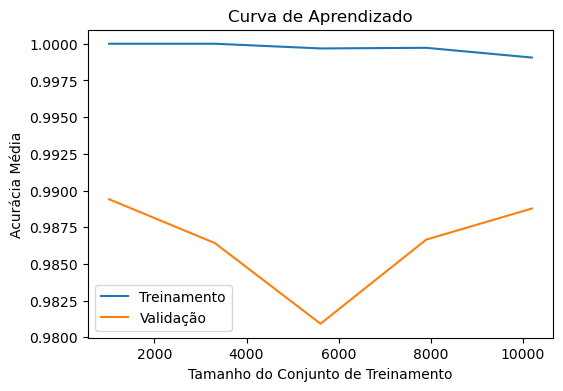

In [107]:
# Criar modelo
gb_classifier = GradientBoostingClassifier(random_state=42)

# Exibir a curva de aprendizado
cv_stratified = StratifiedKFold(n_splits=5)  # 5 splits
train_sizes, train_scores, test_scores = learning_curve(
    gb_classifier, X_train_combined, y_train_comb_discretized, cv=cv_stratified)

plt.figure(figsize=(6, 4))
plt.plot(train_sizes, np.mean(train_scores, axis=1), label='Treinamento')
plt.plot(train_sizes, np.mean(test_scores, axis=1), label='Validação')
plt.title('Curva de Aprendizado')
plt.xlabel('Tamanho do Conjunto de Treinamento')
plt.ylabel('Acurácia Média')
plt.legend()
plt.show()


### Criando o modelo

In [109]:
from sklearn.ensemble import GradientBoostingClassifier

boost = GradientBoostingClassifier(learning_rate=0.1,
    n_estimators=100,
    max_depth=8,
    random_state=1)

boost.fit(X_train_combined, y_train_comb_discretized)
    
print("Test Accuracy 602: %0.2f" % boost.score(X_test, y_test_discretized))

Test Accuracy 602: 0.97


### Resultados 

In [110]:
# Fazer previsões no conjunto de teste
y_pred = boost.predict(X_test)

# Calcular a matriz de confusão
conf_matrix = confusion_matrix(y_test_discretized, y_pred)

# Exibir a matriz de confusão
print("Matriz de Confusão:")
print(conf_matrix)

# Calcular o relatório de classificação
class_report602 = classification_report(y_test_discretized, y_pred, output_dict=True)

# Exibir o relatório de classificação
print("\nRelatório de Classificação:")
print(class_report602)

# Resultados

results_602 = {
    'Technique': 'Modelo 602',
    'Precision': class_report602['weighted avg']['precision'],
    'Recall': class_report602['weighted avg']['recall'],
    'F1 Score': class_report602['weighted avg']['f1-score'],
    'Test Accuracy': "602: %0.2f" % boost.score(X_test, y_test_discretized)
}


Matriz de Confusão:
[[  2   8]
 [ 15 740]]

Relatório de Classificação:
{'MODERATE': {'precision': 0.11764705882352941, 'recall': 0.2, 'f1-score': 0.14814814814814817, 'support': 10.0}, 'WEAK': {'precision': 0.9893048128342246, 'recall': 0.9801324503311258, 'f1-score': 0.9846972721224218, 'support': 755.0}, 'accuracy': 0.9699346405228758, 'macro avg': {'precision': 0.553475935828877, 'recall': 0.590066225165563, 'f1-score': 0.566422710135285, 'support': 765.0}, 'weighted avg': {'precision': 0.9779105938275487, 'recall': 0.9699346405228758, 'f1-score': 0.9737619894560914, 'support': 765.0}}


### Trabalho 1

In [111]:
# Importando o Dataset
file = open('A602.pickle' , 'rb')
(X_train , y_train , X_val , y_val , X_test , y_test) = pickle.load(file)
print(f"Shapes: ", X_train.shape , X_val.shape , X_test.shape, y_train.shape , y_val.shape , y_test.shape)

Shapes:  (10178, 24) (2565, 24) (765, 24) (10178, 1) (2565, 1) (765, 1)


In [112]:
# Substituindo todos os valores diferentes de zero por 1

y_train[y_train != 0] = 1
y_val[y_val != 0] = 1
y_test[y_test != 0] = 1

# Salve as variáveis
with open('A602_substituido.pickle', 'wb') as file:
  pickle.dump((y_train, y_val, y_test), file)

In [113]:
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.2, random_state=42, stratify=y_train)
gb_base = GradientBoostingClassifier()
gb_base.fit(X_train, y_train.ravel())
print("Test Accuracy Base: %0.2f" % gb_base.score(X_test, y_test))

Test Accuracy Base: 0.82


In [114]:
# Avaliar o desempenho no modelo base
y_pred_base = gb_base.predict(X_test)
confusion_matrix_base = confusion_matrix(y_test, y_pred_base)
classification_report_base = classification_report(y_test, y_pred_base, output_dict=True)

results_t1 = {
    'Technique': 'Modelo Trabalho 1',
    'Precision': classification_report_base['weighted avg']['precision'],
    'Recall': classification_report_base['weighted avg']['recall'],
    'F1 Score': classification_report_base['weighted avg']['f1-score'],
    'Test Accuracy': "T1: %0.2f" % gb_base.score(X_test, y_test)
}

### Resultado Final - A602

In [115]:
# Criar um DataFrame a partir dos resultados
results_final = [results_602,results_t1]
results_df = pd.DataFrame(results_final)

# Exibir a tabela final
print(results_df.to_markdown(index=False))

| Technique         |   Precision |   Recall |   F1 Score | Test Accuracy   |
|:------------------|------------:|---------:|-----------:|:----------------|
| Modelo 602        |    0.977911 | 0.969935 |   0.973762 | 602: 0.97       |
| Modelo Trabalho 1 |    0.867194 | 0.819608 |   0.837985 | T1: 0.82        |


### A621

In [117]:
# Importando o Dataset
file = open('A621.pickle' , 'rb')
(X_train , y_train , X_val , y_val , X_test , y_test) = pickle.load(file)
print(f"Shapes: ", X_train.shape , X_val.shape , X_test.shape, y_train.shape , y_val.shape , y_test.shape)

Shapes:  (9549, 24) (2428, 24) (10080, 24) (9549, 1) (2428, 1) (10080, 1)


In [118]:
X_train_combined = np.concatenate((X_train, X_val), axis=0)
y_train_combined = np.concatenate((y_train, y_val), axis=0)

### Discretização

In [119]:
# Converta as séries de dados para arrays unidimensionais

y_train_array = np.squeeze(np.asarray(y_train))
y_val_array = np.squeeze(np.asarray(y_val))
y_test_array = np.squeeze(np.asarray(y_test))

# Defina os limites para discretização
bins = [float('-inf'), 0, 5, 25, 50, float('inf')]

# Defina os rótulos para cada categoria
labels = ['NONE', 'WEAK', 'MODERATE', 'STRONG', 'EXTREME']
#labels = ['0', '1', '2', '3', '4']

# Discretize as séries de dados
y_train_discretized = pd.cut(y_train_array, bins=bins, labels=labels, right=False)
y_val_discretized = pd.cut(y_val_array, bins=bins, labels=labels, right=False)
y_test_discretized = pd.cut(y_test_array, bins=bins, labels=labels, right=False)

In [120]:
# Agora, y_train_discretized, y_val_discretized e y_test_discretized contêm as classes discretizadas

print(y_train_discretized.categories)

Index(['NONE', 'WEAK', 'MODERATE', 'STRONG', 'EXTREME'], dtype='object')


In [121]:
y_train_comb_discretized = np.concatenate((y_train_discretized, y_val_discretized), axis=0)

In [122]:
print(f"Shapes: ", y_train_comb_discretized.shape , y_test_discretized.shape)

Shapes:  (11977,) (10080,)


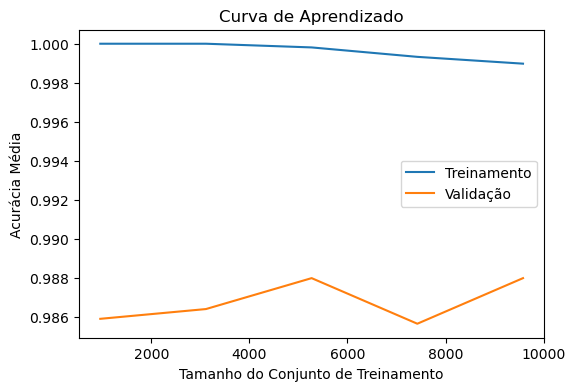

In [123]:
# Criar modelo
gb_classifier = GradientBoostingClassifier(random_state=42)

# Exibir a curva de aprendizado
cv_stratified = StratifiedKFold(n_splits=5)  # 5 splits
train_sizes, train_scores, test_scores = learning_curve(
    gb_classifier, X_train_combined, y_train_comb_discretized, cv=cv_stratified)

plt.figure(figsize=(6, 4))
plt.plot(train_sizes, np.mean(train_scores, axis=1), label='Treinamento')
plt.plot(train_sizes, np.mean(test_scores, axis=1), label='Validação')
plt.title('Curva de Aprendizado')
plt.xlabel('Tamanho do Conjunto de Treinamento')
plt.ylabel('Acurácia Média')
plt.legend()
plt.show()


### Criando o modelo

In [125]:
from sklearn.ensemble import GradientBoostingClassifier

boost = GradientBoostingClassifier(learning_rate=0.1,
    n_estimators=100, 
    max_depth=8,
    random_state=1)

boost.fit(X_train_combined, y_train_comb_discretized)
    
print("Test Accuracy 621: %0.2f" % boost.score(X_test, y_test_discretized))

Test Accuracy 621: 0.99


### Resultados 

In [126]:
# Fazer previsões no conjunto de teste
y_pred = boost.predict(X_test)

# Calcular a matriz de confusão
conf_matrix = confusion_matrix(y_test_discretized, y_pred)

# Exibir a matriz de confusão
print("Matriz de Confusão:")
print(conf_matrix)

# Calcular o relatório de classificação
class_report621 = classification_report(y_test_discretized, y_pred, output_dict=True)

# Exibir o relatório de classificação
print("\nRelatório de Classificação:")
print(class_report621)

# Resultados

results_621 = {
    'Technique': 'Modelo 621',
    'Precision': class_report621['weighted avg']['precision'],
    'Recall': class_report621['weighted avg']['recall'],
    'F1 Score': class_report621['weighted avg']['f1-score'],
    'Test Accuracy': "621: %0.2f" % boost.score(X_test, y_test_discretized)
}


Matriz de Confusão:
[[   0    0    0    1]
 [   0    5    4   67]
 [   0    0    0    9]
 [   0   24    5 9965]]


C:\Users\educl\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\educl\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\educl\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))



Relatório de Classificação:
{'EXTREME': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 1.0}, 'MODERATE': {'precision': 0.1724137931034483, 'recall': 0.06578947368421052, 'f1-score': 0.09523809523809525, 'support': 76.0}, 'STRONG': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9.0}, 'WEAK': {'precision': 0.9923322047400917, 'recall': 0.9970982589553732, 'f1-score': 0.9947095228588541, 'support': 9994.0}, 'accuracy': 0.9890873015873016, 'macro avg': {'precision': 0.291186499460885, 'recall': 0.26572193315989595, 'f1-score': 0.27248690452423735, 'support': 10080.0}, 'weighted avg': {'precision': 0.985165823655589, 'recall': 0.9890873015873016, 'f1-score': 0.9869409788382424, 'support': 10080.0}}


### Trabalho 1

In [127]:
# Importando o Dataset
file = open('A621.pickle' , 'rb')
(X_train , y_train , X_val , y_val , X_test , y_test) = pickle.load(file)
print(f"Shapes: ", X_train.shape , X_val.shape , X_test.shape, y_train.shape , y_val.shape , y_test.shape)

Shapes:  (9549, 24) (2428, 24) (10080, 24) (9549, 1) (2428, 1) (10080, 1)


In [128]:
# Substituindo todos os valores diferentes de zero por 1

y_train[y_train != 0] = 1
y_val[y_val != 0] = 1
y_test[y_test != 0] = 1

# Salve as variáveis
with open('A621_substituido.pickle', 'wb') as file:
  pickle.dump((y_train, y_val, y_test), file)

In [129]:
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.2, random_state=42, stratify=y_train)
gb_base = GradientBoostingClassifier()
gb_base.fit(X_train, y_train.ravel())
print("Test Accuracy Base: %0.2f" % gb_base.score(X_test, y_test))

Test Accuracy Base: 0.91


In [130]:
# Avaliar o desempenho no modelo base
y_pred_base = gb_base.predict(X_test)
confusion_matrix_base = confusion_matrix(y_test, y_pred_base)
classification_report_base = classification_report(y_test, y_pred_base, output_dict=True)

results_t1 = {
    'Technique': 'Modelo Trabalho 1',
    'Precision': classification_report_base['weighted avg']['precision'],
    'Recall': classification_report_base['weighted avg']['recall'],
    'F1 Score': classification_report_base['weighted avg']['f1-score'],
    'Test Accuracy': "T1: %0.2f" % gb_base.score(X_test, y_test)
}

### Resultado Final - A621

In [131]:
# Criar um DataFrame a partir dos resultados
results_final = [results_621,results_t1]
results_df = pd.DataFrame(results_final)

# Exibir a tabela final
print(results_df.to_markdown(index=False))

| Technique         |   Precision |   Recall |   F1 Score | Test Accuracy   |
|:------------------|------------:|---------:|-----------:|:----------------|
| Modelo 621        |    0.985166 | 0.989087 |   0.986941 | 621: 0.99       |
| Modelo Trabalho 1 |    0.915012 | 0.912897 |   0.913914 | T1: 0.91        |


### A627

In [132]:
# Importando o Dataset
file = open('A627.pickle' , 'rb')
(X_train , y_train , X_val , y_val , X_test , y_test) = pickle.load(file)
print(f"Shapes: ", X_train.shape , X_val.shape , X_test.shape, y_train.shape , y_val.shape , y_test.shape)

Shapes:  (9682, 24) (2235, 24) (10202, 24) (9682, 1) (2235, 1) (10202, 1)


In [133]:
X_train_combined = np.concatenate((X_train, X_val), axis=0)
y_train_combined = np.concatenate((y_train, y_val), axis=0)

### Discretização

In [134]:
# Converta as séries de dados para arrays unidimensionais

y_train_array = np.squeeze(np.asarray(y_train))
y_val_array = np.squeeze(np.asarray(y_val))
y_test_array = np.squeeze(np.asarray(y_test))

# Defina os limites para discretização
bins = [float('-inf'), 0, 5, 25, 50, float('inf')]

# Defina os rótulos para cada categoria
labels = ['NONE', 'WEAK', 'MODERATE', 'STRONG', 'EXTREME']
#labels = ['0', '1', '2', '3', '4']

# Discretize as séries de dados
y_train_discretized = pd.cut(y_train_array, bins=bins, labels=labels, right=False)
y_val_discretized = pd.cut(y_val_array, bins=bins, labels=labels, right=False)
y_test_discretized = pd.cut(y_test_array, bins=bins, labels=labels, right=False)

In [135]:
# Agora, y_train_discretized, y_val_discretized e y_test_discretized contêm as classes discretizadas

print(y_train_discretized.categories)

Index(['NONE', 'WEAK', 'MODERATE', 'STRONG', 'EXTREME'], dtype='object')


In [136]:
y_train_comb_discretized = np.concatenate((y_train_discretized, y_val_discretized), axis=0)

In [137]:
print(f"Shapes: ", y_train_comb_discretized.shape , y_test_discretized.shape)

Shapes:  (11917,) (10202,)


C:\Users\educl\anaconda3\Lib\site-packages\sklearn\model_selection\_split.py:737: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(


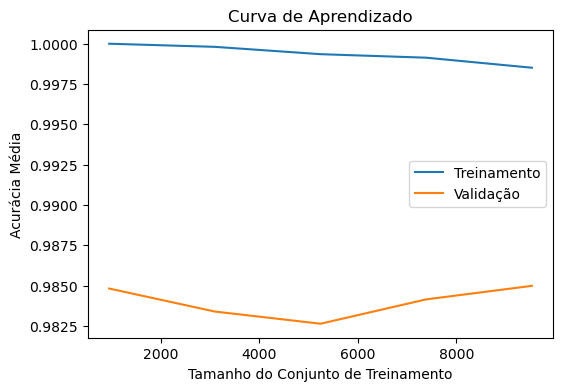

In [138]:
# Criar modelo
gb_classifier = GradientBoostingClassifier(random_state=42)

# Exibir a curva de aprendizado
cv_stratified = StratifiedKFold(n_splits=5)  # 5 splits
train_sizes, train_scores, test_scores = learning_curve(
    gb_classifier, X_train_combined, y_train_comb_discretized, cv=cv_stratified)

plt.figure(figsize=(6, 4))
plt.plot(train_sizes, np.mean(train_scores, axis=1), label='Treinamento')
plt.plot(train_sizes, np.mean(test_scores, axis=1), label='Validação')
plt.title('Curva de Aprendizado')
plt.xlabel('Tamanho do Conjunto de Treinamento')
plt.ylabel('Acurácia Média')
plt.legend()
plt.show()


### Criando o modelo

In [140]:
from sklearn.ensemble import GradientBoostingClassifier

boost = GradientBoostingClassifier(learning_rate=0.1,
    n_estimators=100,
    max_depth=8,
    random_state=1)

boost.fit(X_train_combined, y_train_comb_discretized)
    
print("Test Accuracy 627: %0.2f" % boost.score(X_test, y_test_discretized))

Test Accuracy 627: 0.98


### Resultados 

In [141]:
# Fazer previsões no conjunto de teste
y_pred = boost.predict(X_test)

# Calcular a matriz de confusão
conf_matrix = confusion_matrix(y_test_discretized, y_pred)

# Exibir a matriz de confusão
print("Matriz de Confusão:")
print(conf_matrix)

# Calcular o relatório de classificação
class_report627 = classification_report(y_test_discretized, y_pred, output_dict=True)

# Exibir o relatório de classificação
print("\nRelatório de Classificação:")
print(class_report627)

# Resultados

results_627 = {
    'Technique': 'Modelo 627',
    'Precision': class_report627['weighted avg']['precision'],
    'Recall': class_report627['weighted avg']['recall'],
    'F1 Score': class_report627['weighted avg']['f1-score'],
    'Test Accuracy': "627: %0.2f" % boost.score(X_test, y_test_discretized)
}


Matriz de Confusão:
[[    0     0     0     0]
 [    0    14     0    68]
 [    0     0     0     6]
 [    1    62    21 10030]]


C:\Users\educl\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\educl\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\educl\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))



Relatório de Classificação:
{'EXTREME': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 0.0}, 'MODERATE': {'precision': 0.18421052631578946, 'recall': 0.17073170731707318, 'f1-score': 0.17721518987341772, 'support': 82.0}, 'STRONG': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 6.0}, 'WEAK': {'precision': 0.9926761678543151, 'recall': 0.9916946806406961, 'f1-score': 0.9921851815214164, 'support': 10114.0}, 'accuracy': 0.9845128406194864, 'macro avg': {'precision': 0.29422167354252615, 'recall': 0.2906065969894423, 'f1-score': 0.29235009284870855, 'support': 10202.0}, 'weighted avg': {'precision': 0.9855941996506997, 'recall': 0.9845128406194864, 'f1-score': 0.9850512224541489, 'support': 10202.0}}


### Trabalho 1

In [142]:
# Importando o Dataset
file = open('A627.pickle' , 'rb')
(X_train , y_train , X_val , y_val , X_test , y_test) = pickle.load(file)
print(f"Shapes: ", X_train.shape , X_val.shape , X_test.shape, y_train.shape , y_val.shape , y_test.shape)

Shapes:  (9682, 24) (2235, 24) (10202, 24) (9682, 1) (2235, 1) (10202, 1)


In [143]:
# Substituindo todos os valores diferentes de zero por 1

y_train[y_train != 0] = 1
y_val[y_val != 0] = 1
y_test[y_test != 0] = 1

# Salve as variáveis
with open('A627_substituido.pickle', 'wb') as file:
  pickle.dump((y_train, y_val, y_test), file)

In [144]:
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.2, random_state=42, stratify=y_train)
gb_base = GradientBoostingClassifier()
gb_base.fit(X_train, y_train.ravel())
print("Test Accuracy Base: %0.2f" % gb_base.score(X_test, y_test))

Test Accuracy Base: 0.93


In [145]:
# Avaliar o desempenho no modelo base
y_pred_base = gb_base.predict(X_test)
confusion_matrix_base = confusion_matrix(y_test, y_pred_base)
classification_report_base = classification_report(y_test, y_pred_base, output_dict=True)

results_t1 = {
    'Technique': 'Modelo Trabalho 1',
    'Precision': classification_report_base['weighted avg']['precision'],
    'Recall': classification_report_base['weighted avg']['recall'],
    'F1 Score': classification_report_base['weighted avg']['f1-score'],
    'Test Accuracy': "T1: %0.2f" % gb_base.score(X_test, y_test)
}

### Resultado Final - A627

In [146]:
# Criar um DataFrame a partir dos resultados
results_final = [results_627,results_t1]
results_df = pd.DataFrame(results_final)

# Exibir a tabela final
print(results_df.to_markdown(index=False))

| Technique         |   Precision |   Recall |   F1 Score | Test Accuracy   |
|:------------------|------------:|---------:|-----------:|:----------------|
| Modelo 627        |    0.985594 | 0.984513 |   0.985051 | 627: 0.98       |
| Modelo Trabalho 1 |    0.925747 | 0.929426 |   0.927262 | T1: 0.93        |


### A636

In [147]:
import pickle
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.metrics import accuracy_score
from sklearn.model_selection import learning_curve, StratifiedKFold
from numpy import loadtxt
from xgboost import XGBClassifier
from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay


# Importando o Dataset
file = open('A636.pickle' , 'rb')
(X_train , y_train , X_val , y_val , X_test , y_test) = pickle.load(file)
print(f"Shapes: ", X_train.shape , X_val.shape , X_test.shape, y_train.shape , y_val.shape , y_test.shape)

Shapes:  (10219, 24) (2414, 24) (10129, 24) (10219, 1) (2414, 1) (10129, 1)


In [148]:
X_train_combined = np.concatenate((X_train, X_val), axis=0)
y_train_combined = np.concatenate((y_train, y_val), axis=0)

### Discretização

In [149]:
# Converta as séries de dados para arrays unidimensionais

y_train_array = np.squeeze(np.asarray(y_train))
y_val_array = np.squeeze(np.asarray(y_val))
y_test_array = np.squeeze(np.asarray(y_test))

# Defina os limites para discretização
bins = [float('-inf'), 0, 5, 25, 50, float('inf')]

# Defina os rótulos para cada categoria
labels = ['NONE', 'WEAK', 'MODERATE', 'STRONG', 'EXTREME']
#labels = ['0', '1', '2', '3', '4']

# Discretize as séries de dados
y_train_discretized = pd.cut(y_train_array, bins=bins, labels=labels, right=False)
y_val_discretized = pd.cut(y_val_array, bins=bins, labels=labels, right=False)
y_test_discretized = pd.cut(y_test_array, bins=bins, labels=labels, right=False)

In [150]:
# Agora, y_train_discretized, y_val_discretized e y_test_discretized contêm as classes discretizadas

print(y_train_discretized.categories)

Index(['NONE', 'WEAK', 'MODERATE', 'STRONG', 'EXTREME'], dtype='object')


In [151]:
y_train_comb_discretized = np.concatenate((y_train_discretized, y_val_discretized), axis=0)

In [152]:
print(f"Shapes: ", y_train_comb_discretized.shape , y_test_discretized.shape)

Shapes:  (12633,) (10129,)


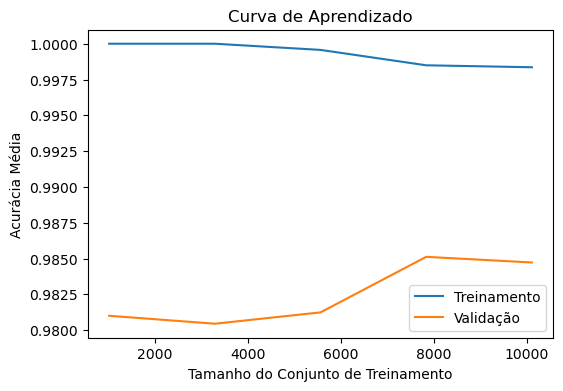

In [153]:
# Criar modelo
gb_classifier = GradientBoostingClassifier(random_state=42)

# Exibir a curva de aprendizado
cv_stratified = StratifiedKFold(n_splits=5)  # 5 splits
train_sizes, train_scores, test_scores = learning_curve(
    gb_classifier, X_train_combined, y_train_comb_discretized, cv=cv_stratified)

plt.figure(figsize=(6, 4))
plt.plot(train_sizes, np.mean(train_scores, axis=1), label='Treinamento')
plt.plot(train_sizes, np.mean(test_scores, axis=1), label='Validação')
plt.title('Curva de Aprendizado')
plt.xlabel('Tamanho do Conjunto de Treinamento')
plt.ylabel('Acurácia Média')
plt.legend()
plt.show()


### Criando o modelo

In [154]:
from sklearn.ensemble import GradientBoostingClassifier

boost = GradientBoostingClassifier(learning_rate=0.1,
    n_estimators=100, # T
    max_depth=8,
    random_state=1)

boost.fit(X_train_combined, y_train_comb_discretized)
    
print("Test Accuracy 636: %0.2f" % boost.score(X_test, y_test_discretized))

Test Accuracy 636: 0.98


### Resultados 

In [155]:
# Fazer previsões no conjunto de teste
y_pred = boost.predict(X_test)

# Calcular a matriz de confusão
conf_matrix = confusion_matrix(y_test_discretized, y_pred)

# Exibir a matriz de confusão
print("Matriz de Confusão:")
print(conf_matrix)

# Calcular o relatório de classificação
class_report636 = classification_report(y_test_discretized, y_pred, output_dict=True)

# Exibir o relatório de classificação
print("\nRelatório de Classificação:")
print(class_report636)

# Resultados

results_636 = {
    'Technique': 'Modelo 636',
    'Precision': class_report636['weighted avg']['precision'],
    'Recall': class_report636['weighted avg']['recall'],
    'F1 Score': class_report636['weighted avg']['f1-score'],
    'Test Accuracy': "636: %0.2f" % boost.score(X_test, y_test_discretized)
}


Matriz de Confusão:
[[   0    1    0    0]
 [   0   26    0   88]
 [   0    3    0    6]
 [   0   79    9 9917]]


C:\Users\educl\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\educl\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\educl\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))



Relatório de Classificação:
{'EXTREME': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 1.0}, 'MODERATE': {'precision': 0.23853211009174313, 'recall': 0.22807017543859648, 'f1-score': 0.23318385650224213, 'support': 114.0}, 'STRONG': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 9.0}, 'WEAK': {'precision': 0.9906103286384976, 'recall': 0.9912043978010995, 'f1-score': 0.9909072741806555, 'support': 10005.0}, 'accuracy': 0.9816368841938987, 'macro avg': {'precision': 0.3072856096825602, 'recall': 0.304818643309924, 'f1-score': 0.3060227826707244, 'support': 10129.0}, 'weighted avg': {'precision': 0.9811678347890836, 'recall': 0.9816368841938987, 'f1-score': 0.9814009515074256, 'support': 10129.0}}


### Trabalho 1

In [156]:
# Importando o Dataset
file = open('A636.pickle' , 'rb')
(X_train , y_train , X_val , y_val , X_test , y_test) = pickle.load(file)
print(f"Shapes: ", X_train.shape , X_val.shape , X_test.shape, y_train.shape , y_val.shape , y_test.shape)

Shapes:  (10219, 24) (2414, 24) (10129, 24) (10219, 1) (2414, 1) (10129, 1)


In [157]:
# Substituindo todos os valores diferentes de zero por 1

y_train[y_train != 0] = 1
y_val[y_val != 0] = 1
y_test[y_test != 0] = 1

# Salve as variáveis
with open('A636_substituido.pickle', 'wb') as file:
  pickle.dump((y_train, y_val, y_test), file)

In [158]:
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.2, random_state=42, stratify=y_train)
gb_base = GradientBoostingClassifier()
gb_base.fit(X_train, y_train.ravel())
print("Test Accuracy Base: %0.2f" % gb_base.score(X_test, y_test))

Test Accuracy Base: 0.92


In [159]:
# Avaliar o desempenho no modelo base
y_pred_base = gb_base.predict(X_test)
confusion_matrix_base = confusion_matrix(y_test, y_pred_base)
classification_report_base = classification_report(y_test, y_pred_base, output_dict=True)

results_t1 = {
    'Technique': 'Modelo Trabalho 1',
    'Precision': classification_report_base['weighted avg']['precision'],
    'Recall': classification_report_base['weighted avg']['recall'],
    'F1 Score': classification_report_base['weighted avg']['f1-score'],
    'Test Accuracy': "T1: %0.2f" % gb_base.score(X_test, y_test)
}

### Resultado Final - A636

In [160]:
# Criar um DataFrame a partir dos resultados
results_final = [results_636,results_t1]
results_df = pd.DataFrame(results_final)

# Exibir a tabela final
print(results_df.to_markdown(index=False))

| Technique         |   Precision |   Recall |   F1 Score | Test Accuracy   |
|:------------------|------------:|---------:|-----------:|:----------------|
| Modelo 636        |    0.981168 | 0.981637 |   0.981401 | 636: 0.98       |
| Modelo Trabalho 1 |    0.916587 | 0.920328 |   0.918158 | T1: 0.92        |


### A652

In [86]:
# Importando o Dataset
file = open('A652.pickle' , 'rb')
(X_train , y_train , X_val , y_val , X_test , y_test) = pickle.load(file)
print(f"Shapes: ", X_train.shape , X_val.shape , X_test.shape, y_train.shape , y_val.shape , y_test.shape)

Shapes:  (10012, 24) (2506, 24) (9582, 24) (10012, 1) (2506, 1) (9582, 1)


In [87]:
X_train_combined = np.concatenate((X_train, X_val), axis=0)
y_train_combined = np.concatenate((y_train, y_val), axis=0)

### Discretização

In [88]:
# Converta as séries de dados para arrays unidimensionais

y_train_array = np.squeeze(np.asarray(y_train))
y_val_array = np.squeeze(np.asarray(y_val))
y_test_array = np.squeeze(np.asarray(y_test))

# Defina os limites para discretização
bins = [float('-inf'), 0, 5, 25, 50, float('inf')]

# Defina os rótulos para cada categoria
labels = ['NONE', 'WEAK', 'MODERATE', 'STRONG', 'EXTREME']
#labels = ['0', '1', '2', '3', '4']

# Discretize as séries de dados
y_train_discretized = pd.cut(y_train_array, bins=bins, labels=labels, right=False)
y_val_discretized = pd.cut(y_val_array, bins=bins, labels=labels, right=False)
y_test_discretized = pd.cut(y_test_array, bins=bins, labels=labels, right=False)

In [89]:
# Agora, y_train_discretized, y_val_discretized e y_test_discretized contêm as classes discretizadas

print(y_train_discretized.categories)

Index(['NONE', 'WEAK', 'MODERATE', 'STRONG', 'EXTREME'], dtype='object')


In [90]:
y_train_comb_discretized = np.concatenate((y_train_discretized, y_val_discretized), axis=0)

In [91]:
print(f"Shapes: ", y_train_comb_discretized.shape , y_test_discretized.shape)

Shapes:  (12518,) (9582,)


C:\Users\educl\anaconda3\Lib\site-packages\sklearn\model_selection\_split.py:737: UserWarning: The least populated class in y has only 3 members, which is less than n_splits=5.
  warnings.warn(


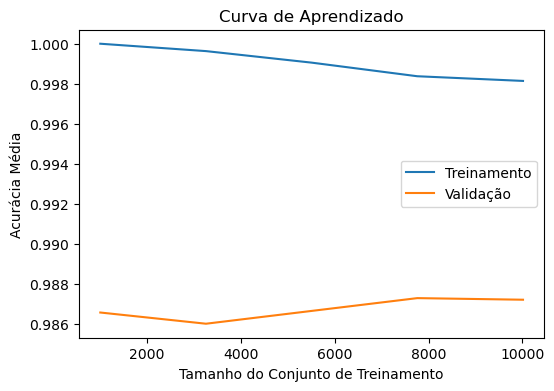

In [92]:
# Criar modelo
gb_classifier = GradientBoostingClassifier(random_state=42)

# Exibir a curva de aprendizado
cv_stratified = StratifiedKFold(n_splits=5)  # 5 splits
train_sizes, train_scores, test_scores = learning_curve(
    gb_classifier, X_train_combined, y_train_comb_discretized, cv=cv_stratified)

plt.figure(figsize=(6, 4))
plt.plot(train_sizes, np.mean(train_scores, axis=1), label='Treinamento')
plt.plot(train_sizes, np.mean(test_scores, axis=1), label='Validação')
plt.title('Curva de Aprendizado')
plt.xlabel('Tamanho do Conjunto de Treinamento')
plt.ylabel('Acurácia Média')
plt.legend()
plt.show()

### Criando o modelo

In [93]:
from sklearn.ensemble import GradientBoostingClassifier

boost = GradientBoostingClassifier(learning_rate=0.1,
    n_estimators=100,
    max_depth=8,
    random_state=1)

boost.fit(X_train_combined, y_train_comb_discretized)
    
print("Test Accuracy 652: %0.2f" % boost.score(X_test, y_test_discretized))

Test Accuracy 652: 0.99


### Resultados 

In [94]:
# Fazer previsões no conjunto de teste
y_pred = boost.predict(X_test)

# Calcular a matriz de confusão
conf_matrix = confusion_matrix(y_test_discretized, y_pred)

# Exibir a matriz de confusão
print("Matriz de Confusão:")
print(conf_matrix)

# Calcular o relatório de classificação
class_report652 = classification_report(y_test_discretized, y_pred, output_dict=True)

# Exibir o relatório de classificação
print("\nRelatório de Classificação:")
print(class_report652)

# Resultados

results_652 = {
    'Technique': 'Modelo 652',
    'Precision': class_report652['weighted avg']['precision'],
    'Recall': class_report652['weighted avg']['recall'],
    'F1 Score': class_report652['weighted avg']['f1-score'],
    'Test Accuracy': "652: %0.2f" % boost.score(X_test, y_test_discretized)
}


Matriz de Confusão:
[[   0    0    0    2]
 [   0    2    0   49]
 [   0    0    1    3]
 [   0   36    1 9488]]

Relatório de Classificação:
{'EXTREME': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 2.0}, 'MODERATE': {'precision': 0.05263157894736842, 'recall': 0.0392156862745098, 'f1-score': 0.0449438202247191, 'support': 51.0}, 'STRONG': {'precision': 0.5, 'recall': 0.25, 'f1-score': 0.3333333333333333, 'support': 4.0}, 'WEAK': {'precision': 0.9943408090547056, 'recall': 0.9961154855643045, 'f1-score': 0.995227356165102, 'support': 9525.0}, 'accuracy': 0.9905030265080359, 'macro avg': {'precision': 0.38674309700051845, 'recall': 0.3213327929597036, 'f1-score': 0.3433761274307886, 'support': 9582.0}, 'weighted avg': {'precision': 0.9889146750962624, 'recall': 0.9905030265080359, 'f1-score': 0.9896854556081601, 'support': 9582.0}}


C:\Users\educl\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\educl\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\educl\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


### Trabalho 1

In [95]:
# Importando o Dataset
file = open('A652.pickle' , 'rb')
(X_train , y_train , X_val , y_val , X_test , y_test) = pickle.load(file)
print(f"Shapes: ", X_train.shape , X_val.shape , X_test.shape, y_train.shape , y_val.shape , y_test.shape)

Shapes:  (10012, 24) (2506, 24) (9582, 24) (10012, 1) (2506, 1) (9582, 1)


In [96]:
# Substituindo todos os valores diferentes de zero por 1

y_train[y_train != 0] = 1
y_val[y_val != 0] = 1
y_test[y_test != 0] = 1

# Salve as variáveis
with open('A652_substituido.pickle', 'wb') as file:
  pickle.dump((y_train, y_val, y_test), file)

In [97]:
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.2, random_state=42, stratify=y_train)
gb_base = GradientBoostingClassifier()
gb_base.fit(X_train, y_train.ravel())
print("Test Accuracy Base: %0.2f" % gb_base.score(X_test, y_test))

Test Accuracy Base: 0.93


In [98]:
# Avaliar o desempenho no modelo base
y_pred_base = gb_base.predict(X_test)
confusion_matrix_base = confusion_matrix(y_test, y_pred_base)
classification_report_base = classification_report(y_test, y_pred_base, output_dict=True)

results_t1 = {
    'Technique': 'Modelo Trabalho 1',
    'Precision': classification_report_base['weighted avg']['precision'],
    'Recall': classification_report_base['weighted avg']['recall'],
    'F1 Score': classification_report_base['weighted avg']['f1-score'],
    'Test Accuracy': "T1: %0.2f" % gb_base.score(X_test, y_test)
}

### Resultado Final - A652

In [99]:
# Criar um DataFrame a partir dos resultados
results_final = [results_652,results_t1]
results_df = pd.DataFrame(results_final)

# Exibir a tabela final
print(results_df.to_markdown(index=False))

| Technique         |   Precision |   Recall |   F1 Score | Test Accuracy   |
|:------------------|------------:|---------:|-----------:|:----------------|
| Modelo 652        |    0.988915 | 0.990503 |   0.989685 | 652: 0.99       |
| Modelo Trabalho 1 |    0.925573 | 0.934669 |   0.925007 | T1: 0.93        |


# 4 SHAP Values

Shap values é uma técnica que ajuda na interpretação prévia do modelo que vai se construir. Analisando o efeito de contriibuição de cada feature no modelo. X(i)-> M -> y 

Importando os datasets

In [1]:
import pandas as pd
import numpy as np

A602test = "C:/Users/educl/A602_test.parquet.gzip"
A602val = "C:/Users/educl/A602_val.parquet.gzip"
A602train = "C:/Users/educl/A602_train.parquet.gzip"

df_A602test = pd.read_parquet(A602test)
df_A602val = pd.read_parquet(A602val)
df_A602train = pd.read_parquet(A602train)


A621test = "C:/Users/educl/A621_test.parquet.gzip"
A621val = "C:/Users/educl/A621_val.parquet.gzip"
A621train = "C:/Users/educl/A621_train.parquet.gzip"

df_A621test = pd.read_parquet(A621test)
df_A621val = pd.read_parquet(A621val)
df_A621train = pd.read_parquet(A621train)


A627test = "C:/Users/educl/A627_test.parquet.gzip"
A627val = "C:/Users/educl/A627_val.parquet.gzip"
A627train = "C:/Users/educl/A627_train.parquet.gzip"

df_A627test = pd.read_parquet(A627test)
df_A627val = pd.read_parquet(A627val)
df_A627train = pd.read_parquet(A627train)


A636test = "C:/Users/educl/A636_test.parquet.gzip"
A636val = "C:/Users/educl/A636_val.parquet.gzip"
A636train = "C:/Users/educl/A636_train.parquet.gzip"

df_A636test = pd.read_parquet(A636test)
df_A636val = pd.read_parquet(A636val)
df_A636train = pd.read_parquet(A636train)


A652test = "C:/Users/educl/A652_test.parquet.gzip"
A652val = "C:/Users/educl/A652_val.parquet.gzip"
A652train = "C:/Users/educl/A652_train.parquet.gzip"

df_A652test = pd.read_parquet(A652test)
df_A652val = pd.read_parquet(A652val)
df_A652train = pd.read_parquet(A652train)


In [2]:
# Validando o tamanho dos dataset's
df_A602test.shape, df_A602val.shape, df_A602train.shape, df_A621test.shape, df_A621val.shape, df_A621train.shape, df_A627test.shape, df_A627val.shape, df_A627train.shape, df_A636test.shape, df_A636val.shape, df_A636train.shape,df_A652test.shape, df_A652val.shape, df_A652train.shape

((768, 8),
 (2571, 8),
 (10280, 8),
 (10095, 8),
 (2434, 8),
 (9736, 8),
 (10217, 8),
 (2429, 8),
 (9715, 8),
 (10157, 8),
 (2564, 8),
 (10252, 8),
 (9594, 8),
 (2515, 8),
 (10059, 8))

Verificando os dados em um dataset

In [3]:
df_A602test.head()

,temperature,barometric_pressure,relative_humidity,wind_direction_u,wind_direction_v,hour_sin,hour_cos,precipitation
2021-11-30 00:00:00,0.507788,0.136364,0.838384,0.468940,0.402363,0.500000,1.000000,0.0
2021-11-30 01:00:00,0.467290,0.150568,0.868687,0.492492,0.427580,0.629410,0.982963,0.0
2021-11-30 02:00:00,0.454829,0.159091,0.888889,0.454839,0.417035,0.750000,0.933013,0.0
2021-11-30 03:00:00,0.457944,0.153409,0.898990,0.434599,0.407663,0.853553,0.853553,0.0
2021-11-30 04:00:00,0.423676,0.122159,0.919192,0.459862,0.437374,0.933013,0.750000,0.0


### Concatenação dos conjuntos de treinamento e validação

In [4]:
df_A602comb= pd.concat([df_A602train, df_A602val], axis=0)
df_A621comb= pd.concat([df_A621train, df_A621val], axis=0)
df_A627comb= pd.concat([df_A627train, df_A627val], axis=0)
df_A636comb= pd.concat([df_A636train, df_A636val], axis=0)
df_A652comb= pd.concat([df_A652train, df_A652val], axis=0)

In [5]:
df_A602comb.shape, df_A621comb.shape, df_A627comb.shape, df_A636comb.shape, df_A652comb.shape

((12851, 8), (12170, 8), (12144, 8), (12816, 8), (12574, 8))

### É observado que no dataset a variável precipitação tem uma variação entre (0 a +00 mm/h). Para analise com a técnica do Shapvalue, iremos binarizar essa variável para facilitar as interpretações futuras. Será definido sem precipitação a variação ("0" = 0 mm/h) e precipitado "1", onde ocorreu algum tipo de precipitação acima de 0mm/h.

### A602

In [6]:
precipitation_comb = df_A602comb['precipitation']
print("Valores de precipitation em df_A602comb:")
print(precipitation_comb.unique())

Valores de precipitation em df_A602comb:
[ 0.   1.   4.2  1.2  1.6  4.4  1.4  0.2  0.4  8.   0.8  0.6  2.2  3.4
  5.   1.8  7.8  2.4  3.8  4.6  7.4  6.6 36.8  2.6  6.8  2.   5.8  3.
  9.   2.8  3.6  5.2  4.8  3.2 18.  14.8 15.  14.4  9.8 10.   6.2  5.4
  6.   8.2 14.2  7.6  9.6  4.   5.6  7.  12.6  6.4  8.6 19.2 12.8 16.4
  8.4  8.8 11.  39.2 20.4 11.8 18.6 10.6]


### Diferenciando as variáveis independentes da variável preditora dependente

In [7]:
X_602comb = df_A602comb.drop(columns=['precipitation'])
y_602comb = df_A602comb.precipitation

X_602test = df_A602test.drop(columns=['precipitation'])
y_602test = df_A602test.precipitation

In [8]:
X_602comb.shape, y_602comb.shape

((12851, 7), (12851,))

In [9]:
print(X_602test.columns)

Index(['temperature', 'barometric_pressure', 'relative_humidity',
       'wind_direction_u', 'wind_direction_v', 'hour_sin', 'hour_cos'],
      dtype='object')


In [10]:
y_602test = y_602test.rename("precipitation")

In [11]:
nome_da_coluna = y_602test.name
print(nome_da_coluna)

precipitation


In [17]:
y_602comb.unique()

array([0., 1.])

In [18]:
X_602test.shape, y_602test.shape

((768, 7), (768,))

In [19]:
y_602test.unique()

array([0., 1.])

### Binarizando a variável preditora precipitação

In [20]:
y_602comb[y_602comb != 0] = 1
y_602test[y_602test != 0] = 1

In [21]:
y_602comb.unique(), y_602test.unique()

(array([0., 1.]), array([0., 1.]))

### Algumas estatísticas A602

In [22]:
X_602comb.describe()

,temperature,barometric_pressure,relative_humidity,wind_direction_u,wind_direction_v,hour_sin,hour_cos
count,12851.000000,12851.000000,12851.000000,12851.000000,12851.000000,12851.000000,12851.000000
mean,0.439439,0.443012,0.816708,0.447351,0.459185,0.500913,0.497889
std,0.116318,0.112784,0.118980,0.076943,0.076386,0.354129,0.352997
min,0.130841,0.071023,0.212121,0.142865,0.153175,0.000000,0.000000
25%,0.361371,0.366477,0.757576,0.413917,0.408173,0.146447,0.146447
50%,0.426791,0.440341,0.848485,0.455389,0.454751,0.500000,0.500000
75%,0.498442,0.519886,0.898990,0.485557,0.509245,0.853553,0.853553
max,0.968847,0.775568,1.000000,0.774435,0.874051,1.000000,1.000000


### Ajustando um modelo para ser usado posteriormente nos próximos exemplos. Implementando o GradientBoostingClassifier

In [23]:
from sklearn.ensemble import GradientBoostingClassifier
seed = 42
gb_602comb = GradientBoostingClassifier(random_state=seed)
gb_602comb.fit(X_602comb.values, y_602comb.values)

GradientBoostingClassifier(random_state=42)

### Vamos usar a biblioteca SHAP para interpretar seu comportamento de previsão. O TreeExplainer é projetado especificamente para modelos baseados em árvores.

In [24]:
import shap

explainer602 = shap.TreeExplainer(gb_602comb)
shap_values602 = explainer602.shap_values(X_602test)

In [25]:
shap_values602

array([[-0.36082682,  0.32936555, -0.57473178, ..., -0.08253419,
         0.00606664,  0.14317256],
       [ 0.12984444,  0.42073878,  0.26280331, ..., -0.01503806,
        -0.13570317,  0.10022149],
       [ 0.21688339,  0.45606642,  0.84437849, ..., -0.04425517,
        -0.2293    ,  0.16691645],
       ...,
       [ 0.109887  ,  0.38924404,  1.80667657, ..., -0.04254918,
         0.55071171,  0.14733631],
       [ 0.11735212,  0.39639721,  2.07488251, ..., -0.00737117,
         0.55500375,  0.48485096],
       [ 0.13295288,  0.40391094,  2.07920076, ..., -0.02885653,
         0.41053846,  0.48486928]])

In [26]:
shap_values602.shape

(768, 7)

### Importância das Features

In [27]:
print(X_602test.iloc[0,:])

temperature            0.507788
barometric_pressure    0.136364
relative_humidity      0.838384
wind_direction_u       0.468940
wind_direction_v       0.402363
hour_sin               0.500000
hour_cos               1.000000
Name: 2021-11-30 00:00:00, dtype: float64


In [28]:
print(explainer602.expected_value)

[-3.20940228]


In [29]:
first_instance = X_602test.iloc[0,:].values.reshape(1, -1)
gb_602comb.predict(first_instance)

array([0.])

In [30]:
gb_602comb.predict_proba(first_instance)

array([[0.97953276, 0.02046724]])

In [31]:
X_602test.temperature.unique()

array([0.50778816, 0.46728972, 0.45482866, 0.45794393, 0.42367601,
       0.42056075, 0.44548287, 0.43302181, 0.47663551, 0.51090343,
       0.54517134, 0.5482866 , 0.46105919, 0.48286604, 0.48598131,
       0.4517134 , 0.42679128, 0.41121495, 0.40186916, 0.38629283,
       0.37071651, 0.38317757, 0.41744548, 0.42990654, 0.43925234,
       0.4423676 , 0.44859813, 0.49221184, 0.4953271 , 0.41433022,
       0.3894081 , 0.37694704, 0.36448598, 0.47352025, 0.48909657,
       0.40498442, 0.39252336, 0.39563863, 0.36760125, 0.34890966,
       0.39875389, 0.46417445, 0.40809969, 0.35825545, 0.33333333,
       0.31152648, 0.32087227, 0.50155763, 0.33021807, 0.32398754,
       0.5046729 , 0.52959502, 0.57320872, 0.56386293, 0.37383178,
       0.38006231, 0.35514019, 0.36137072, 0.47040498, 0.43613707,
       0.34579439, 0.49844237, 0.35202492, 0.30529595, 0.30841121,
       0.30218069, 0.29906542, 0.29283489, 0.31775701, 0.3271028 ,
       0.29595016, 0.28971963, 0.3364486 , 0.33956386, 0.28348

In [32]:
print(X_602test.columns)

Index(['temperature', 'barometric_pressure', 'relative_humidity',
       'wind_direction_u', 'wind_direction_v', 'hour_sin', 'hour_cos'],
      dtype='object')


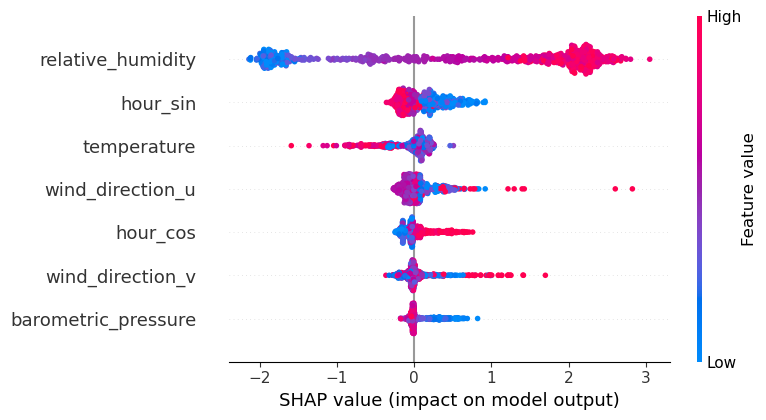

In [33]:
shap.summary_plot(shap_values602[:], X_602test)

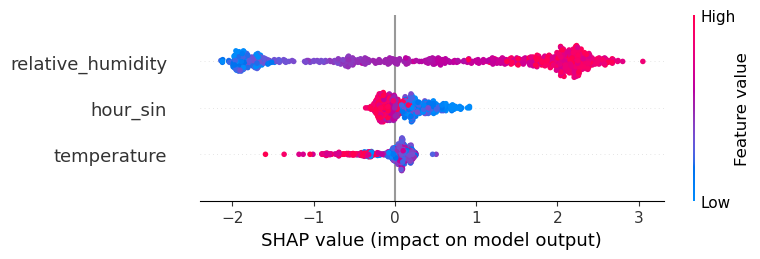

In [34]:
shap.summary_plot(shap_values602[:], X_602test, max_display=3)

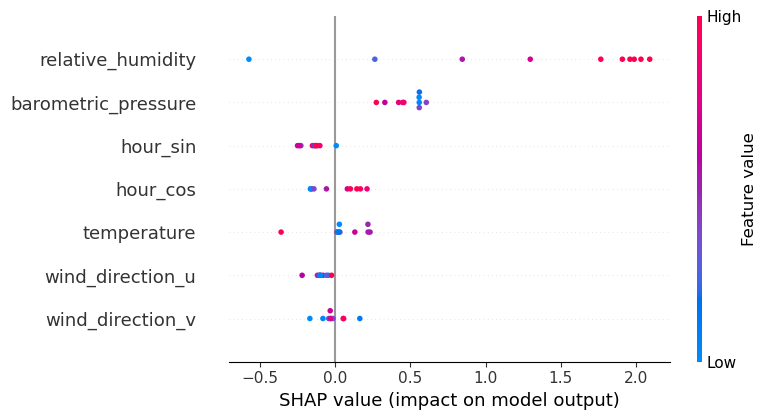

In [35]:
shap.summary_plot(shap_values602[:][:10], X_602test.head(10))

In [36]:
shap.plots.initjs()

In [37]:
shap_values_single = shap_values602[:]
shap_base_value = explainer602.expected_value[:]  

# Crie um objeto Explanation
shap_explanation = shap.Explanation(shap_base_value, shap_values_single, feature_names=X_602test.columns)

# Crie um gráfico de force usando shap.plots.force
shap.plots.force(shap_base_value, shap_values_single, features=X_602test)

### A621

In [133]:
precipitation_comb = df_A621comb['precipitation']
print("Valores de precipitation em df_A621comb:")
print(precipitation_comb.unique())

Valores de precipitation em df_A621comb:
[ 0.  26.4  6.6  1.2  0.2  0.8  0.6  5.6  6.4  3.4  0.4  4.4  2.4  5.
  4.6  3.6  2.6  4.8 15.   3.2  1.4  5.4  2.  18.   1.8  1.6  7.8  1.
  2.2 30.6 11.  24.6 47.6 16.2  6.8  4.2  7.  15.4 13.2  9.6  5.8 32.2
 17.2 34.  33.8 19.6  2.8 12.   3.8 10.8 13.4  3.   8.4  9.2  4.  11.8
  6.2  8.2 13.6  7.2  7.4  8.8 16.6  9.8 11.6 21.2  8.  14.  10.4 30.4
 10.  32.   7.6  6. ]


### Diferenciando as variáveis independentes da variável preditora dependente

In [134]:
X_621comb = df_A621comb.drop(columns=['precipitation'])
y_621comb = df_A621comb.precipitation

X_621test = df_A621test.drop(columns=['precipitation'])
y_621test = df_A621test.precipitation

In [135]:
X_621comb.shape, y_621comb.shape

((12170, 7), (12170,))

In [136]:
print(X_621test.columns)

Index(['temperature', 'barometric_pressure', 'relative_humidity',
       'wind_direction_u', 'wind_direction_v', 'hour_sin', 'hour_cos'],
      dtype='object')


In [137]:
y_621test = y_621test.rename("precipitation")

In [138]:
nome_da_coluna = y_621test.name
print(nome_da_coluna)

precipitation


In [139]:
y_621comb.unique()

array([ 0. , 26.4,  6.6,  1.2,  0.2,  0.8,  0.6,  5.6,  6.4,  3.4,  0.4,
        4.4,  2.4,  5. ,  4.6,  3.6,  2.6,  4.8, 15. ,  3.2,  1.4,  5.4,
        2. , 18. ,  1.8,  1.6,  7.8,  1. ,  2.2, 30.6, 11. , 24.6, 47.6,
       16.2,  6.8,  4.2,  7. , 15.4, 13.2,  9.6,  5.8, 32.2, 17.2, 34. ,
       33.8, 19.6,  2.8, 12. ,  3.8, 10.8, 13.4,  3. ,  8.4,  9.2,  4. ,
       11.8,  6.2,  8.2, 13.6,  7.2,  7.4,  8.8, 16.6,  9.8, 11.6, 21.2,
        8. , 14. , 10.4, 30.4, 10. , 32. ,  7.6,  6. ])

In [140]:
X_621test.shape, y_621test.shape

((10095, 7), (10095,))

In [141]:
y_621test.unique()

array([ 0. ,  0.8,  0.6,  0.2,  1. ,  2.6,  5.4,  1.2,  0.4,  3.8,  7. ,
        3.2,  5.8,  1.8,  8. , 14.4, 12.8,  1.6,  9.2,  1.4,  2.8,  2. ,
       45. ,  3.6,  3.4,  4.8,  2.2,  5.6,  8.4,  6.2, 18.2, 13.4,  5.2,
        4.2, 18.8,  4.6,  7.2,  3. ,  9. , 23.4, 56.6, 12. ,  4. ,  5. ,
        7.6, 10.8,  4.4, 26. ,  9.4,  8.6,  2.4,  9.8, 29.2,  8.2, 10.6,
        6.4, 10.4, 35.4, 20.8,  6.8, 11. ,  6. , 13.2, 49.8, 29.4, 16.4,
       20.6, 11.6, 13. , 18.6, 16.8, 17.6, 17.8, 11.8, 21. , 31.4, 47.2,
        7.8, 43.4,  7.4])

### Binarizando a variável preditora precipitação

In [142]:
y_621comb[y_621comb != 0] = 1
y_621test[y_621test != 0] = 1

In [143]:
y_621comb.unique(), y_621test.unique()

(array([0., 1.]), array([0., 1.]))

### Algumas estatísticas A621

In [144]:
X_621comb.describe()

,temperature,barometric_pressure,relative_humidity,wind_direction_u,wind_direction_v,hour_sin,hour_cos
count,12170.000000,12170.000000,12170.000000,12170.000000,12170.000000,12170.000000,12170.000000
mean,0.498902,0.469476,0.735393,0.417217,0.605080,0.494162,0.493714
std,0.131802,0.114052,0.207312,0.053811,0.066287,0.353494,0.353538
min,0.086567,0.094017,0.034483,0.128782,0.170443,0.000000,0.000000
25%,0.405970,0.390313,0.574713,0.395415,0.584230,0.146447,0.146447
50%,0.483582,0.467236,0.781609,0.407084,0.605861,0.500000,0.500000
75%,0.579104,0.547009,0.919540,0.435865,0.646487,0.853553,0.853553
max,0.952239,0.797721,1.000000,0.661599,0.814340,1.000000,1.000000


Ajustando um modelo para ser usado posteriormente nos próximos exemplos. Implementando o GradientBoostingClassifier

In [145]:
from sklearn.ensemble import GradientBoostingClassifier
seed = 42
gb_621comb = GradientBoostingClassifier(random_state=seed)
gb_621comb.fit(X_621comb.values, y_621comb.values)

GradientBoostingClassifier(random_state=42)

Vamos usar a biblioteca SHAP para interpretar seu comportamento de previsão. O TreeExplainer é projetado especificamente para modelos baseados em árvores.

In [146]:
import shap

explainer621 = shap.TreeExplainer(gb_621comb)
shap_values621 = explainer621.shap_values(X_621test)

In [147]:
shap_values621

array([[-0.76280945,  0.88488099,  0.01242475, ...,  0.04293407,
        -0.19734864, -0.19519271],
       [-0.72225087,  0.88521872,  0.2131312 , ..., -0.08863181,
        -0.13616059,  0.04166775],
       [-0.68424711,  0.86943704,  0.86696597, ..., -0.10373283,
        -0.36403867,  0.04581788],
       ...,
       [-0.38335715, -0.10690471,  0.11883192, ...,  0.08847845,
         0.78142268,  0.11040094],
       [-0.27434872,  0.15469842, -0.39440906, ...,  0.1269149 ,
         0.64669816,  0.05252453],
       [-0.35980367,  0.15813505, -0.38246745, ...,  0.08811703,
         0.72926936, -0.07495963]])

In [148]:
shap_values621.shape

(10095, 7)

Importância das Features

In [149]:
print(X_621test.iloc[0,:])

temperature            0.650746
barometric_pressure    0.162393
relative_humidity      0.781609
wind_direction_u       0.379059
wind_direction_v       0.618455
hour_sin               0.500000
hour_cos               1.000000
Name: 2021-11-30 00:00:00, dtype: float64


In [150]:
print(explainer621.expected_value)

[-3.19346865]


In [151]:
first_instance621 = X_621test.iloc[0,:].values.reshape(1, -1)
gb_621comb.predict(first_instance621)

array([0.])

In [152]:
gb_621comb.predict_proba(first_instance621)

array([[0.96792294, 0.03207706]])

In [153]:
X_621test.temperature.unique()

array([0.65074627, 0.60597015, 0.5761194 , 0.48358209, 0.46865672,
       0.46268657, 0.50149254, 0.49253731, 0.49552239, 0.59104478,
       0.59701493, 0.61492537, 0.6238806 , 0.62985075, 0.6119403 ,
       0.64776119, 0.62686567, 0.58507463, 0.56119403, 0.52537313,
       0.50746269, 0.48955224, 0.48656716, 0.48059701, 0.47462687,
       0.46567164, 0.45970149, 0.45671642, 0.42985075, 0.53731343,
       0.54029851, 0.57014925, 0.62089552, 0.66865672, 0.68059701,
       0.68656716, 0.61791045, 0.60298507, 0.52835821, 0.45373134,
       0.4358209 , 0.40298507, 0.42089552, 0.49850746, 0.53432836,
       0.5641791 , 0.58208955, 0.64179104, 0.63283582, 0.51641791,
       0.45074627, 0.44477612, 0.43880597, 0.4238806 , 0.41791045,
       0.4119403 , 0.44776119, 0.47164179, 0.54626866, 0.55223881,
       0.38208955, 0.3761194 , 0.34328358, 0.31641791, 0.34626866,
       0.55522388, 0.52238806, 0.57910448, 0.5880597 , 0.51940299,
       0.42686567, 0.4       , 0.53134328, 0.65671642, 0.69253

In [154]:
print(X_621test.columns)

Index(['temperature', 'barometric_pressure', 'relative_humidity',
       'wind_direction_u', 'wind_direction_v', 'hour_sin', 'hour_cos'],
      dtype='object')


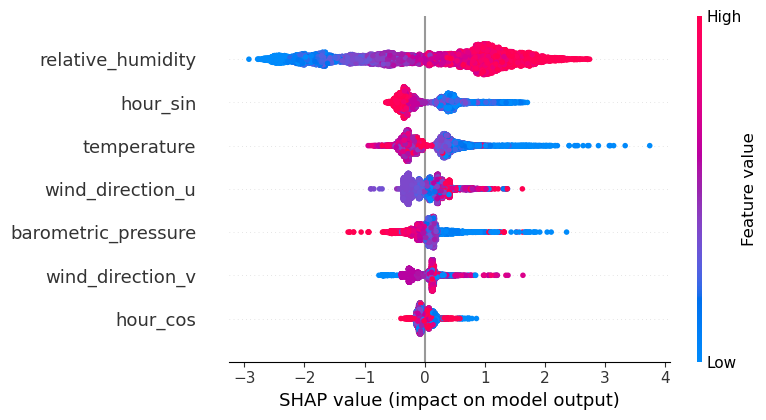

In [155]:
shap.summary_plot(shap_values621[:], X_621test)

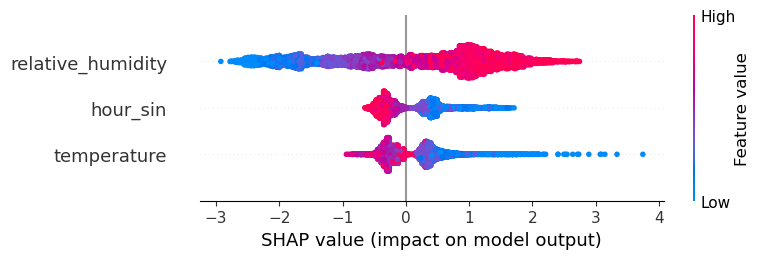

In [156]:
shap.summary_plot(shap_values621[:], X_621test, max_display=3)

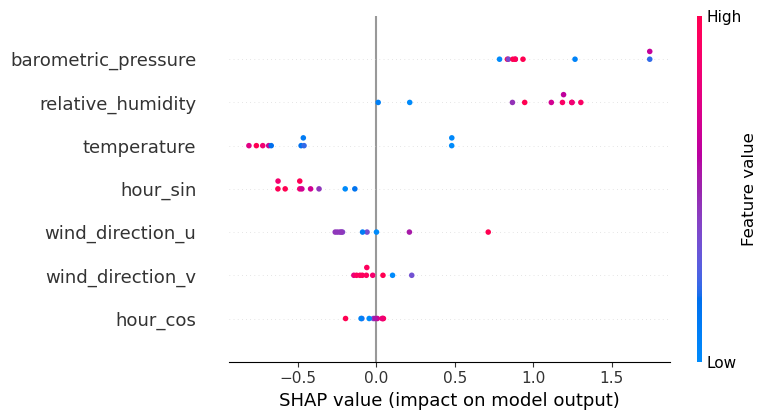

In [157]:
shap.summary_plot(shap_values621[:][:10], X_621test.head(10))

In [158]:
shap.plots.initjs()

In [160]:
shap_values621_single = shap_values621[:]
shap_base621_value = explainer621.expected_value[:]  

# Crie um objeto Explanation
shap_explanation621 = shap.Explanation(shap_base621_value, shap_values621_single, feature_names=X_621test.columns)

# Crie um gráfico de force usando shap.plots.force
shap.plots.force(shap_base621_value, shap_values621_single, features=X_621test)

shap.plots.force is slow for many thousands of rows, try subsampling your data.


### A627

In [6]:
precipitation_comb = df_A627comb['precipitation']
print("Valores de precipitation em df_A627comb:")
print(precipitation_comb.unique())

Valores de precipitation em df_A627comb:
[ 0.   2.6 12.4  6.8  1.   0.6  0.2  5.   2.4  4.6  2.8  4.4 15.4  0.8
  0.4  8.8  3.4  3.  28.4  8.   3.6 22.   5.8  5.6  9.  18.8 13.6  1.4
  4.2  3.8  1.6  2.   1.2  6.2  1.8 10.4 11.6  5.2  8.2 37.   7.6 16.4
  2.2  3.2 20.4  7.2 15.2 22.8  6.   6.4 19.8  4.  14.8  8.6 14.   7.8
  4.8  5.4 11.4 49.  16.2  9.6 18.4 37.6 17.6 17.  65.4  9.4 12.2  9.2
  9.8 20.6 29.2 11. ]


### Diferenciando as variáveis independentes da variável preditora dependente

In [7]:
X_627comb = df_A627comb.drop(columns=['precipitation'])
y_627comb = df_A627comb.precipitation

X_627test = df_A627test.drop(columns=['precipitation'])
y_627test = df_A627test.precipitation

In [8]:
X_627comb.shape, y_627comb.shape

((12144, 7), (12144,))

In [9]:
print(X_627test.columns)

Index(['temperature', 'barometric_pressure', 'relative_humidity',
       'wind_direction_u', 'wind_direction_v', 'hour_sin', 'hour_cos'],
      dtype='object')


In [10]:
y_627test = y_627test.rename("precipitation")

In [11]:
nome_da_coluna = y_627test.name
print(nome_da_coluna)

precipitation


In [12]:
y_627comb.unique()

array([ 0. ,  2.6, 12.4,  6.8,  1. ,  0.6,  0.2,  5. ,  2.4,  4.6,  2.8,
        4.4, 15.4,  0.8,  0.4,  8.8,  3.4,  3. , 28.4,  8. ,  3.6, 22. ,
        5.8,  5.6,  9. , 18.8, 13.6,  1.4,  4.2,  3.8,  1.6,  2. ,  1.2,
        6.2,  1.8, 10.4, 11.6,  5.2,  8.2, 37. ,  7.6, 16.4,  2.2,  3.2,
       20.4,  7.2, 15.2, 22.8,  6. ,  6.4, 19.8,  4. , 14.8,  8.6, 14. ,
        7.8,  4.8,  5.4, 11.4, 49. , 16.2,  9.6, 18.4, 37.6, 17.6, 17. ,
       65.4,  9.4, 12.2,  9.2,  9.8, 20.6, 29.2, 11. ])

In [13]:
X_627test.shape, y_627test.shape

((10217, 7), (10217,))

In [14]:
y_627test.unique()

array([ 0. ,  0.4,  0.2,  1. ,  4.8,  0.8,  1.2,  3. ,  0.6, 10.4,  2.4,
        2. ,  1.4,  8.6, 10.6,  6.4,  2.8,  1.8, 15.4,  5.8,  4.2,  5.4,
       15.6,  2.2,  4.6,  8.8,  4.4, 15.8,  1.6, 11. ,  3.8,  2.6,  3.4,
        3.6,  5. , 17.2, 16.8, 14.6,  6.8,  7.8,  6.6, 10.8, 20.4,  6.2,
       25.2,  8.2, 14. ,  7. , 36. , 12.6,  8. ,  4. ,  5.2, 11.8,  3.2,
        5.6, 16.2, 15. , 13.2, 18.2, 22.6, 10.2,  9.8,  7.6,  9. , 33.4,
       36.2, 36.4, 26.6, 17.6,  7.2,  6. ,  9.4, 18. ])

In [15]:
print(X_627test.columns)

Index(['temperature', 'barometric_pressure', 'relative_humidity',
       'wind_direction_u', 'wind_direction_v', 'hour_sin', 'hour_cos'],
      dtype='object')


In [16]:
y_627test = y_627test.rename("precipitation")

In [17]:
nome_da_coluna = y_627test.name
print(nome_da_coluna)

precipitation


In [18]:
y_627comb.unique()

array([ 0. ,  2.6, 12.4,  6.8,  1. ,  0.6,  0.2,  5. ,  2.4,  4.6,  2.8,
        4.4, 15.4,  0.8,  0.4,  8.8,  3.4,  3. , 28.4,  8. ,  3.6, 22. ,
        5.8,  5.6,  9. , 18.8, 13.6,  1.4,  4.2,  3.8,  1.6,  2. ,  1.2,
        6.2,  1.8, 10.4, 11.6,  5.2,  8.2, 37. ,  7.6, 16.4,  2.2,  3.2,
       20.4,  7.2, 15.2, 22.8,  6. ,  6.4, 19.8,  4. , 14.8,  8.6, 14. ,
        7.8,  4.8,  5.4, 11.4, 49. , 16.2,  9.6, 18.4, 37.6, 17.6, 17. ,
       65.4,  9.4, 12.2,  9.2,  9.8, 20.6, 29.2, 11. ])

In [19]:
X_627test.shape, y_627test.shape

((10217, 7), (10217,))

In [20]:
y_627test.unique()

array([ 0. ,  0.4,  0.2,  1. ,  4.8,  0.8,  1.2,  3. ,  0.6, 10.4,  2.4,
        2. ,  1.4,  8.6, 10.6,  6.4,  2.8,  1.8, 15.4,  5.8,  4.2,  5.4,
       15.6,  2.2,  4.6,  8.8,  4.4, 15.8,  1.6, 11. ,  3.8,  2.6,  3.4,
        3.6,  5. , 17.2, 16.8, 14.6,  6.8,  7.8,  6.6, 10.8, 20.4,  6.2,
       25.2,  8.2, 14. ,  7. , 36. , 12.6,  8. ,  4. ,  5.2, 11.8,  3.2,
        5.6, 16.2, 15. , 13.2, 18.2, 22.6, 10.2,  9.8,  7.6,  9. , 33.4,
       36.2, 36.4, 26.6, 17.6,  7.2,  6. ,  9.4, 18. ])

### Binarizando a variável preditora precipitação

In [21]:
y_627comb[y_627comb != 0] = 1
y_627test[y_627test != 0] = 1

In [22]:
y_627comb.unique(), y_627test.unique()

(array([0., 1.]), array([0., 1.]))

### Algumas estatísticas A627

In [23]:
X_627comb.describe()

,temperature,barometric_pressure,relative_humidity,wind_direction_u,wind_direction_v,hour_sin,hour_cos
count,12144.000000,12144.000000,12144.000000,12144.000000,12144.000000,12144.000000,12144.000000
mean,0.462445,0.429040,0.709265,0.564354,0.460594,0.486035,0.494485
std,0.140688,0.118634,0.184173,0.100113,0.104500,0.353044,0.353773
min,0.052448,0.045732,0.026316,0.151645,0.052195,0.000000,0.000000
25%,0.363636,0.347561,0.592105,0.499417,0.385295,0.146447,0.146447
50%,0.444056,0.426829,0.736842,0.563510,0.430016,0.500000,0.500000
75%,0.541958,0.509146,0.855263,0.633911,0.519991,0.853553,0.853553
max,0.986014,0.792683,1.000000,0.913863,1.000000,1.000000,1.000000


Ajustando um modelo para ser usado posteriormente nos próximos exemplos. Implementando o GradientBoostingClassifier

In [24]:
from sklearn.ensemble import GradientBoostingClassifier
seed = 42
gb_627comb = GradientBoostingClassifier(random_state=seed)
gb_627comb.fit(X_627comb.values, y_627comb.values)

GradientBoostingClassifier(random_state=42)

Vamos usar a biblioteca SHAP para interpretar seu comportamento de previsão. O TreeExplainer é projetado especificamente para modelos baseados em árvores.

In [25]:
import shap

explainer627 = shap.TreeExplainer(gb_627comb)
shap_values627 = explainer627.shap_values(X_627test)

In [26]:
shap_values627

array([[ 0.18436342,  0.69475508, -1.16517906, ..., -0.07890344,
         0.13098518,  0.1052891 ],
       [ 0.18113403,  0.7537929 , -0.87873787, ..., -0.03895926,
        -0.32767462,  0.11913369],
       [ 0.1529639 ,  0.72005693, -0.85595207, ..., -0.11162507,
        -0.4945779 , -0.01605534],
       ...,
       [ 0.18118782, -0.0185818 , -2.46338966, ..., -0.04611987,
         0.40519452, -0.10680171],
       [ 0.23622309,  0.11927769, -2.44289052, ...,  0.0115835 ,
         0.41625456, -0.07415344],
       [ 0.25858185,  0.03817196, -2.44343103, ...,  0.26276981,
         0.42883946, -0.10697326]])

In [27]:
shap_values627.shape

(10217, 7)

Importância das Features

In [28]:
print(X_627test.iloc[0,:])

temperature            0.618881
barometric_pressure    0.106707
relative_humidity      0.605263
wind_direction_u       0.603788
wind_direction_v       0.428651
hour_sin               0.500000
hour_cos               1.000000
Name: 2021-11-30 00:00:00, dtype: float64


In [29]:
print(explainer627.expected_value)

[-3.66188713]


In [30]:
first_instance627 = X_627test.iloc[0,:].values.reshape(1, -1)
gb_627comb.predict(first_instance627)

array([0.])

In [31]:
gb_627comb.predict_proba(first_instance627)

array([[0.97908695, 0.02091305]])

In [32]:
X_627test.temperature.unique()

array([0.61888112, 0.58741259, 0.55244755, 0.51748252, 0.48951049,
       0.47902098, 0.47202797, 0.47552448, 0.52097902, 0.58041958,
       0.6048951 , 0.60839161, 0.61188811, 0.5       , 0.48601399,
       0.45804196, 0.44405594, 0.43356643, 0.43006993, 0.42307692,
       0.4020979 , 0.39160839, 0.3951049 , 0.53146853, 0.57692308,
       0.59090909, 0.59440559, 0.54545455, 0.53846154, 0.46153846,
       0.43706294, 0.42657343, 0.41958042, 0.41258741, 0.40559441,
       0.38811189, 0.38461538, 0.40909091, 0.55944056, 0.56293706,
       0.56643357, 0.56993007, 0.52797203, 0.3986014 , 0.37762238,
       0.37412587, 0.35664336, 0.34615385, 0.34965035, 0.36013986,
       0.5034965 , 0.36363636, 0.32867133, 0.32517483, 0.32167832,
       0.31118881, 0.31818182, 0.44055944, 0.50699301, 0.54195804,
       0.49300699, 0.46503497, 0.36713287, 0.33916084, 0.35314685,
       0.66433566, 0.67832168, 0.68181818, 0.67132867, 0.63286713,
       0.61538462, 0.54895105, 0.48251748, 0.44755245, 0.52447

In [33]:
print(X_627test.columns)

Index(['temperature', 'barometric_pressure', 'relative_humidity',
       'wind_direction_u', 'wind_direction_v', 'hour_sin', 'hour_cos'],
      dtype='object')


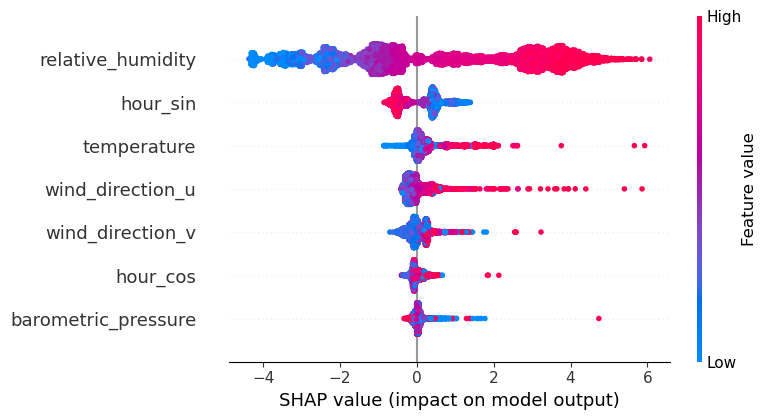

In [34]:
shap.summary_plot(shap_values627[:], X_627test)

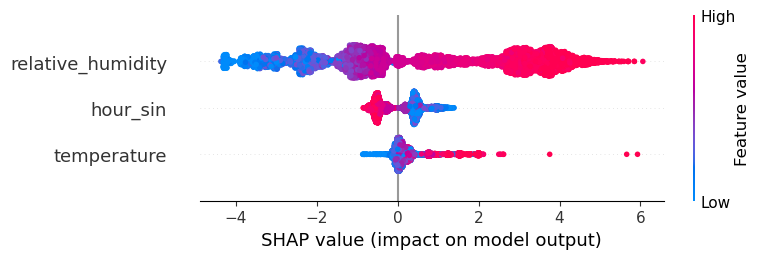

In [35]:
shap.summary_plot(shap_values627[:], X_627test, max_display=3)

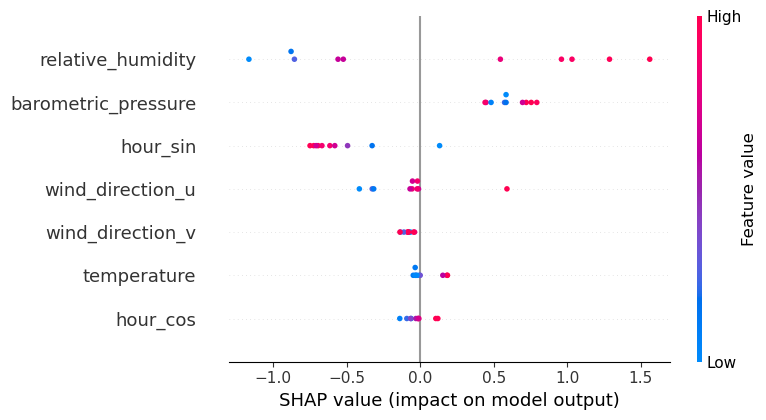

In [36]:
shap.summary_plot(shap_values627[:][:10], X_627test.head(10))

In [37]:
shap.plots.initjs()

In [38]:
shap_values627_single = shap_values627[:]
shap_base627_value = explainer627.expected_value[:]  

# Crie um objeto Explanation
shap_explanation627 = shap.Explanation(shap_base627_value, shap_values627_single, feature_names=X_627test.columns)

# Crie um gráfico de force usando shap.plots.force
shap.plots.force(shap_base627_value, shap_values627_single, features=X_627test)

shap.plots.force is slow for many thousands of rows, try subsampling your data.


### A636

In [39]:
precipitation_comb = df_A636comb['precipitation']
print("Valores de precipitation em df_A636comb:")
print(precipitation_comb.unique())

Valores de precipitation em df_A636comb:
[ 0.   7.2  6.4  0.2  1.   1.8  3.4  0.6  0.8  2.6  0.4  3.2  3.   1.4
  1.2  6.2  3.6  9.8 26.6  2.2  3.8 12.8  5.8 13.   1.6  5.   4.2  7.
  2.   2.4 15.  23.8  4.8 12.   4.4  8.4  9.6 23.6  6.6  8.8  8.   8.6
  7.6  5.6  4.6  5.4 12.4 24.6  6.  10.8 20.6 25.2 10.6  6.8  2.8 19.6
 43.4 30.2  9.4 14.8 14.6  9.2  7.4 15.4 15.8 10.4 11.   5.2 14.2  4.
 15.6 13.8 16.  25.4  7.8 13.2 10.2 16.6 23.2 13.6 16.2 24.4]


### Diferenciando as variáveis independentes da variável preditora dependente

In [40]:
X_636comb = df_A636comb.drop(columns=['precipitation'])
y_636comb = df_A636comb.precipitation

X_636test = df_A636test.drop(columns=['precipitation'])
y_636test = df_A636test.precipitation

In [41]:
X_636comb.shape, y_636comb.shape

((12816, 7), (12816,))

In [42]:
print(X_636test.columns)

Index(['temperature', 'barometric_pressure', 'relative_humidity',
       'wind_direction_u', 'wind_direction_v', 'hour_sin', 'hour_cos'],
      dtype='object')


In [43]:
y_636test = y_636test.rename("precipitation")

In [44]:
nome_da_coluna = y_636test.name
print(nome_da_coluna)

precipitation


In [45]:
y_636comb.unique()

array([ 0. ,  7.2,  6.4,  0.2,  1. ,  1.8,  3.4,  0.6,  0.8,  2.6,  0.4,
        3.2,  3. ,  1.4,  1.2,  6.2,  3.6,  9.8, 26.6,  2.2,  3.8, 12.8,
        5.8, 13. ,  1.6,  5. ,  4.2,  7. ,  2. ,  2.4, 15. , 23.8,  4.8,
       12. ,  4.4,  8.4,  9.6, 23.6,  6.6,  8.8,  8. ,  8.6,  7.6,  5.6,
        4.6,  5.4, 12.4, 24.6,  6. , 10.8, 20.6, 25.2, 10.6,  6.8,  2.8,
       19.6, 43.4, 30.2,  9.4, 14.8, 14.6,  9.2,  7.4, 15.4, 15.8, 10.4,
       11. ,  5.2, 14.2,  4. , 15.6, 13.8, 16. , 25.4,  7.8, 13.2, 10.2,
       16.6, 23.2, 13.6, 16.2, 24.4])

In [46]:
X_636test.shape, y_636test.shape

((10157, 7), (10157,))

In [47]:
y_636test.unique()

array([ 0. ,  0.4,  0.6,  1.2,  0.8,  0.2, 12.6,  2.8,  2.2,  1.4, 10.6,
        4. ,  1. ,  1.6,  1.8, 39.8,  3. ,  2.6,  2. , 17.2, 10.2, 11.8,
        7. ,  9.2,  4.4,  2.4,  6. , 12.2,  9. ,  3.6,  5.2,  3.2,  7.6,
        4.6,  4.2,  3.8,  3.4,  4.8,  5.6, 12. , 22.6, 53.2,  5.8, 10. ,
        6.6,  8.6, 10.8, 14.6, 21.6, 35.8, 40.2,  5.4, 18.2,  6.8,  5. ,
       28.2,  8.4, 15.6, 13.6, 20.8,  6.4, 13.4,  8.8, 16.4, 13. ,  9.8,
       15.8, 14. , 13.2,  8.2, 12.4,  9.4, 19.2,  7.4, 14.2, 15.4, 21.2,
       34.6, 26. , 36.2, 21.8, 45.6, 37.8, 11.6,  7.8])

### Binarizando a variável preditora precipitação

In [48]:
y_636comb[y_636comb != 0] = 1
y_636test[y_636test != 0] = 1

In [49]:
y_636comb.unique(), y_636test.unique()

(array([0., 1.]), array([0., 1.]))

### Algumas estatísticas A636

In [50]:
X_636comb.describe()

,temperature,barometric_pressure,relative_humidity,wind_direction_u,wind_direction_v,hour_sin,hour_cos
count,12816.000000,12816.000000,12816.000000,12816.000000,12816.000000,12816.000000,12816.000000
mean,0.494456,0.427973,0.808269,0.366697,0.454271,0.499777,0.495166
std,0.135744,0.124114,0.176601,0.075405,0.080906,0.354471,0.352628
min,0.144695,0.028037,0.052632,0.013248,0.010191,0.000000,0.000000
25%,0.398714,0.342679,0.697368,0.341978,0.437456,0.146447,0.146447
50%,0.479100,0.423676,0.881579,0.351676,0.444112,0.500000,0.500000
75%,0.581994,0.510903,0.947368,0.393685,0.481687,0.853553,0.853553
max,0.990354,0.794393,1.000000,0.778084,1.000000,1.000000,1.000000


Ajustando um modelo para ser usado posteriormente nos próximos exemplos. Implementando o GradientBoostingClassifier

In [51]:
from sklearn.ensemble import GradientBoostingClassifier
seed = 42
gb_636comb = GradientBoostingClassifier(random_state=seed)
gb_636comb.fit(X_636comb.values, y_636comb.values)

GradientBoostingClassifier(random_state=42)

Vamos usar a biblioteca SHAP para interpretar seu comportamento de previsão. O TreeExplainer é projetado especificamente para modelos baseados em árvores.

In [52]:
import shap

explainer636 = shap.TreeExplainer(gb_636comb)
shap_values636 = explainer636.shap_values(X_636test)

In [53]:
shap_values636

array([[ 0.14256229, -0.15665751,  0.58632245, ..., -0.42878358,
        -0.14624068, -0.00629444],
       [ 0.21171887, -0.12957066,  1.19896669, ..., -0.37723386,
        -0.34491086,  0.26044967],
       [ 0.23367723, -0.12984363,  1.18723697, ..., -0.37721724,
        -0.33345708,  0.18154827],
       ...,
       [-0.05401343, -0.0083128 , -2.20409086, ..., -0.08954722,
         0.74820767, -0.13527549],
       [-0.05966195,  0.01758945, -2.31426005, ...,  0.15217865,
         0.67842582,  0.03754632],
       [-0.26719521,  0.04753438, -2.40477932, ...,  0.35627233,
         0.62132866, -0.02157233]])

In [54]:
shap_values636.shape

(10157, 7)

Importância das Features

In [55]:
print(X_636test.iloc[0,:])

temperature            0.488746
barometric_pressure    0.099688
relative_humidity      0.907895
wind_direction_u       0.351743
wind_direction_v       0.438971
hour_sin               0.500000
hour_cos               1.000000
Name: 2021-11-30 00:00:00, dtype: float64


In [56]:
print(explainer636.expected_value)

[-3.06793286]


In [57]:
first_instance636 = X_636test.iloc[0,:].values.reshape(1, -1)
gb_636comb.predict(first_instance636)

array([0.])

In [58]:
gb_636comb.predict_proba(first_instance636)

array([[0.96308076, 0.03691924]])

In [59]:
X_636test.temperature.unique()

array([0.48874598, 0.46623794, 0.46302251, 0.45980707, 0.47588424,
       0.48231511, 0.49517685, 0.52090032, 0.61093248, 0.62700965,
       0.62379421, 0.60771704, 0.57877814, 0.56270096, 0.5562701 ,
       0.53054662, 0.54019293, 0.51768489, 0.48553055, 0.51446945,
       0.50803859, 0.50482315, 0.45016077, 0.44051447, 0.43729904,
       0.61736334, 0.66559486, 0.61414791, 0.56913183, 0.5659164 ,
       0.50160772, 0.49196141, 0.47909968, 0.45337621, 0.42122186,
       0.40192926, 0.37620579, 0.36012862, 0.60128617, 0.59485531,
       0.59163987, 0.55305466, 0.46945338, 0.45659164, 0.44694534,
       0.41157556, 0.4244373 , 0.40514469, 0.39228296, 0.51125402,
       0.52411576, 0.55948553, 0.39549839, 0.38906752, 0.34726688,
       0.35691318, 0.34405145, 0.30868167, 0.32475884, 0.54662379,
       0.54983923, 0.5755627 , 0.414791  , 0.42765273, 0.35369775,
       0.64308682, 0.63022508, 0.64630225, 0.66237942, 0.65916399,
       0.64951768, 0.63344051, 0.4340836 , 0.40836013, 0.39871

In [60]:
print(X_636test.columns)

Index(['temperature', 'barometric_pressure', 'relative_humidity',
       'wind_direction_u', 'wind_direction_v', 'hour_sin', 'hour_cos'],
      dtype='object')


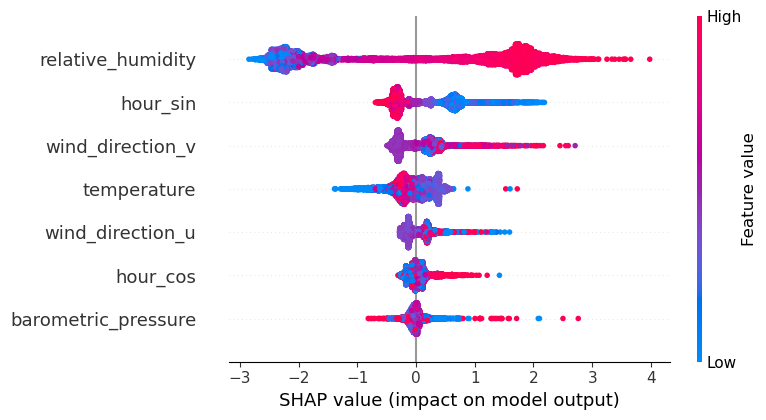

In [61]:
shap.summary_plot(shap_values636[:], X_636test)

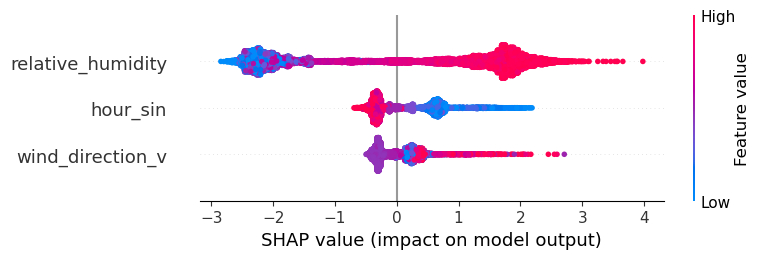

In [62]:
shap.summary_plot(shap_values636[:], X_636test, max_display=3)

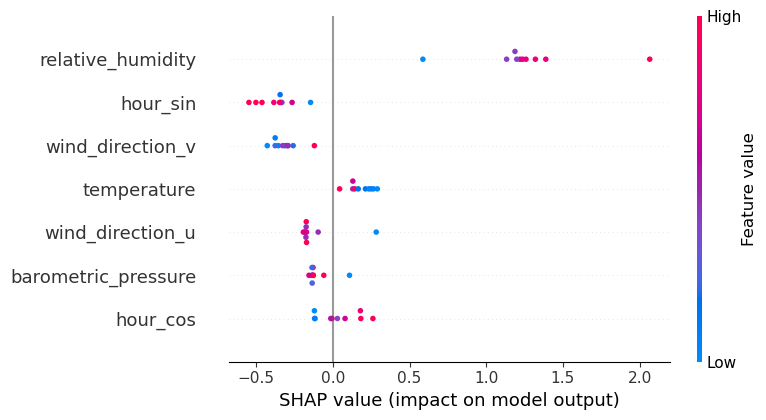

In [63]:
shap.summary_plot(shap_values636[:][:10], X_636test.head(10))

In [64]:
shap.plots.initjs()

In [65]:
shap_values636_single = shap_values636[:]
shap_base636_value = explainer636.expected_value[:]  

# Crie um objeto Explanation
shap_explanation636 = shap.Explanation(shap_base636_value, shap_values636_single, feature_names=X_636test.columns)

# Crie um gráfico de force usando shap.plots.force
shap.plots.force(shap_base636_value, shap_values636_single, features=X_636test)

shap.plots.force is slow for many thousands of rows, try subsampling your data.


### A652

In [235]:
precipitation_comb = df_A652comb['precipitation']
print("Valores de precipitation em df_A652comb:")
print(precipitation_comb.unique())

Valores de precipitation em df_A652comb:
[ 0.  13.4  0.8  0.2  0.4  3.4  2.   2.6  3.8  1.6  0.6  3.   1.2  6.2
  1.  16.8  7.6  1.4  4.6  3.2  1.8  6.6  8.4  2.2 13.6  5.2 19.  18.4
 19.6  8.8  2.8 23.8  2.4  5.4  4.   5.   9.   4.4  4.2  3.6  9.6 11.2
  5.8 16.4  8.2  8.   5.6 10.2 17.8 15.2  7.2 11.8  7.4  6.8  4.8 10.4
 16.2 10.   6.  13.2  6.4 16.6 12.6  9.8 17.2  7.  13.8 12.8 17.6 30.
 32.6 16.  18.2 12.4 29.4]


### Diferenciando as variáveis independentes da variável preditora dependente

In [236]:
X_652comb = df_A652comb.drop(columns=['precipitation'])
y_652comb = df_A652comb.precipitation

X_652test = df_A652test.drop(columns=['precipitation'])
y_652test = df_A652test.precipitation

In [237]:
X_652comb.shape, y_652comb.shape

((12574, 7), (12574,))

In [238]:
print(X_652test.columns)

Index(['temperature', 'barometric_pressure', 'relative_humidity',
       'wind_direction_u', 'wind_direction_v', 'hour_sin', 'hour_cos'],
      dtype='object')


In [239]:
y_652test = y_652test.rename("precipitation")

In [240]:
nome_da_coluna = y_652test.name
print(nome_da_coluna)

precipitation


In [241]:
y_652comb.unique()

array([ 0. , 13.4,  0.8,  0.2,  0.4,  3.4,  2. ,  2.6,  3.8,  1.6,  0.6,
        3. ,  1.2,  6.2,  1. , 16.8,  7.6,  1.4,  4.6,  3.2,  1.8,  6.6,
        8.4,  2.2, 13.6,  5.2, 19. , 18.4, 19.6,  8.8,  2.8, 23.8,  2.4,
        5.4,  4. ,  5. ,  9. ,  4.4,  4.2,  3.6,  9.6, 11.2,  5.8, 16.4,
        8.2,  8. ,  5.6, 10.2, 17.8, 15.2,  7.2, 11.8,  7.4,  6.8,  4.8,
       10.4, 16.2, 10. ,  6. , 13.2,  6.4, 16.6, 12.6,  9.8, 17.2,  7. ,
       13.8, 12.8, 17.6, 30. , 32.6, 16. , 18.2, 12.4, 29.4])

In [242]:
X_652test.shape, y_652test.shape

((9594, 7), (9594,))

In [243]:
y_652test.unique()

array([ 0. ,  0.8,  0.2,  1.8,  0.4,  2.8,  1. , 17.4,  2.2,  2.6,  9.4,
        4.2, 14.8,  1.2,  1.4,  5.8,  8. ,  5.4,  0.6, 11.8,  2.4,  6.2,
       16.4, 16.6,  7. ,  2. ,  6. ,  1.6, 11.6,  3.6,  3.8,  9.2, 10.8,
        3.4,  4.6,  8.2,  4.4,  9.6,  3.2, 60.4, 30.4,  8.6,  9.8,  4.8,
        3. ,  7.6, 12.6, 10.6,  4. ,  5.6, 12.4, 13.2,  5.2,  6.4,  5. ,
       22.8, 19. , 64.4, 35.6, 26.2, 11. ,  9. ,  7.8, 34.2, 19.6])

### Binarizando a variável preditora precipitação

In [244]:
y_652comb[y_652comb != 0] = 1
y_652test[y_652test != 0] = 1

In [245]:
y_652comb.unique(), y_652test.unique()

(array([0., 1.]), array([0., 1.]))

### Algumas estatísticas A652

In [246]:
X_652comb.describe()

,temperature,barometric_pressure,relative_humidity,wind_direction_u,wind_direction_v,hour_sin,hour_cos
count,12574.000000,12574.000000,12574.000000,12574.000000,12574.000000,12574.000000,12574.000000
mean,0.392170,0.466051,0.807684,0.428034,0.501024,0.497989,0.498762
std,0.113786,0.116277,0.098434,0.076421,0.055640,0.353603,0.353524
min,0.035433,0.094118,0.217391,0.113219,0.273591,0.000000,0.000000
25%,0.311024,0.385294,0.750000,0.385601,0.467047,0.146447,0.146447
50%,0.377953,0.464706,0.815217,0.422531,0.489362,0.500000,0.500000
75%,0.460630,0.544118,0.880435,0.474848,0.521523,0.853553,0.853553
max,0.929134,0.841176,1.000000,0.820600,0.966514,1.000000,1.000000


Ajustando um modelo para ser usado posteriormente nos próximos exemplos. Implementando o GradientBoostingClassifier

In [247]:
from sklearn.ensemble import GradientBoostingClassifier
seed = 42
gb_652comb = GradientBoostingClassifier(random_state=seed)
gb_652comb.fit(X_652comb.values, y_652comb.values)

GradientBoostingClassifier(random_state=42)

Vamos usar a biblioteca SHAP para interpretar seu comportamento de previsão. O TreeExplainer é projetado especificamente para modelos baseados em árvores.

In [248]:
import shap

explainer652 = shap.TreeExplainer(gb_652comb)
shap_values652 = explainer652.shap_values(X_652test)

In [249]:
shap_values652

array([[ 0.06803046,  0.08097708, -0.1629477 , ..., -0.17192801,
         0.13843326,  0.02001612],
       [ 0.29665801,  0.08491244,  0.09851402, ..., -0.20359868,
         0.02976324,  0.01774254],
       [ 0.11445494,  0.06544164,  1.01267073, ..., -0.22968973,
        -0.11674753,  0.00935433],
       ...,
       [-0.17846852,  0.01739773, -1.2295498 , ..., -0.0185584 ,
         0.1383479 ,  0.00613419],
       [-0.17694064,  0.01862818, -1.22949906, ..., -0.02151912,
         0.1383479 ,  0.00613419],
       [-0.17242379,  0.02419926, -1.21902029, ..., -0.10466018,
         0.14281591,  0.0096258 ]])

In [250]:
shap_values652.shape

(9594, 7)

Importância das Features

In [251]:
print(X_652test.iloc[0,:])

temperature            0.377953
barometric_pressure    0.150000
relative_humidity      0.836957
wind_direction_u       0.362098
wind_direction_v       0.476953
hour_sin               0.500000
hour_cos               1.000000
Name: 2021-11-30 00:00:00, dtype: float64


In [252]:
print(explainer652.expected_value)

[-3.68174974]


In [253]:
first_instance652 = X_652test.iloc[0,:].values.reshape(1, -1)
gb_652comb.predict(first_instance652)

array([0.])

In [254]:
gb_652comb.predict_proba(first_instance652)

array([[0.98203072, 0.01796928]])

In [255]:
X_652test.temperature.unique()

array([0.37795276, 0.31496063, 0.33858268, 0.41732283, 0.50787402,
       0.5       , 0.45669291, 0.42913386, 0.47637795, 0.41338583,
       0.4488189 , 0.53543307, 0.55905512, 0.38188976, 0.40551181,
       0.42519685, 0.35433071, 0.3976378 , 0.4015748 , 0.38976378,
       0.34251969, 0.37401575, 0.36220472, 0.34645669, 0.33464567,
       0.33070866, 0.37007874, 0.36614173, 0.39370079, 0.38582677,
       0.3503937 , 0.35826772, 0.32677165, 0.31102362, 0.46850394,
       0.48031496, 0.51181102, 0.48425197, 0.44488189, 0.31889764,
       0.30708661, 0.30314961, 0.28740157, 0.50393701, 0.49212598,
       0.57874016, 0.58267717, 0.32283465, 0.43307087, 0.49606299,
       0.58661417, 0.5984252 , 0.54330709, 0.46456693, 0.42125984,
       0.51968504, 0.54724409, 0.56692913, 0.47244094, 0.2992126 ,
       0.27952756, 0.44094488, 0.43700787, 0.29133858, 0.48818898,
       0.25984252, 0.24015748, 0.23622047, 0.22834646, 0.22047244,
       0.24409449, 0.26771654, 0.2480315 , 0.22440945, 0.25590

In [256]:
print(X_652test.columns)

Index(['temperature', 'barometric_pressure', 'relative_humidity',
       'wind_direction_u', 'wind_direction_v', 'hour_sin', 'hour_cos'],
      dtype='object')


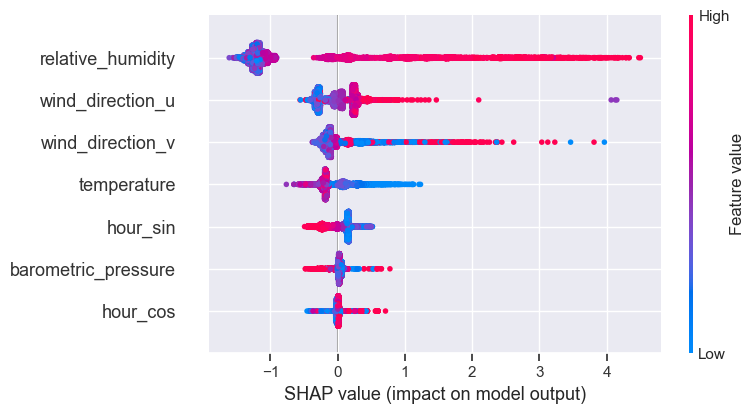

In [257]:
shap.summary_plot(shap_values652[:], X_652test)

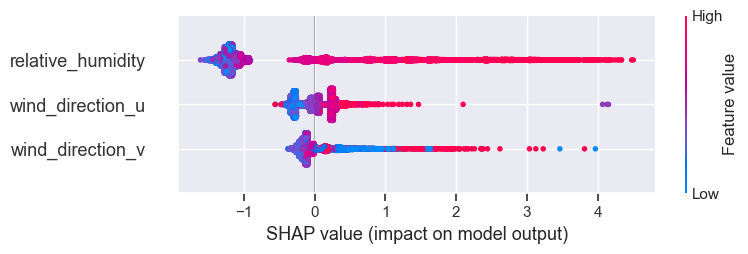

In [258]:
shap.summary_plot(shap_values652[:], X_652test, max_display=3)

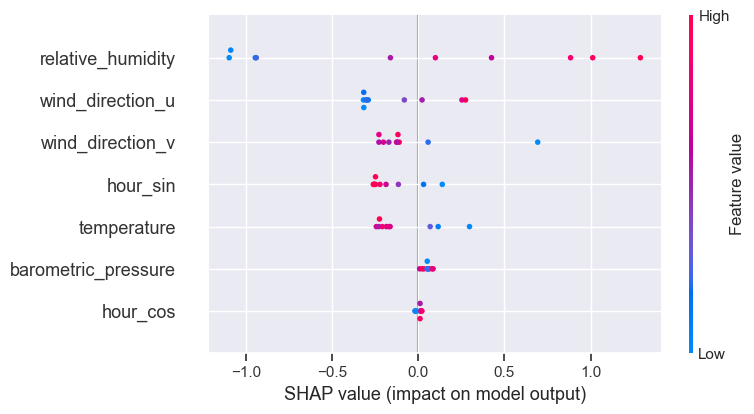

In [259]:
shap.summary_plot(shap_values652[:][:10], X_652test.head(10))

In [260]:
shap.plots.initjs()

In [ ]:
shap_values652_single = shap_values652[:]
shap_base652_value = explainer652.expected_value[:]  

# Crie um objeto Explanation
shap_explanation652 = shap.Explanation(shap_base652_value, shap_values652_single, feature_names=X_652test.columns)

# Crie um gráfico de force usando shap.plots.force
shap.plots.force(shap_base652_value, shap_values652_single, features=X_652test)

shap.plots.force is slow for many thousands of rows, try subsampling your data.


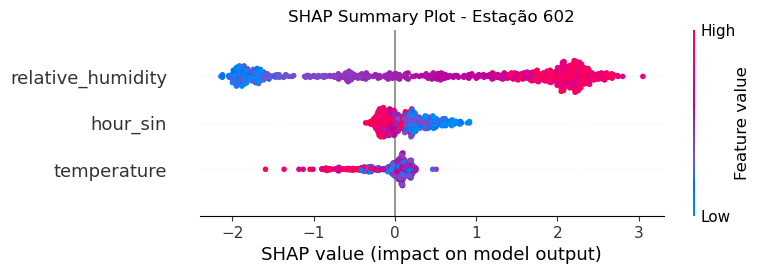

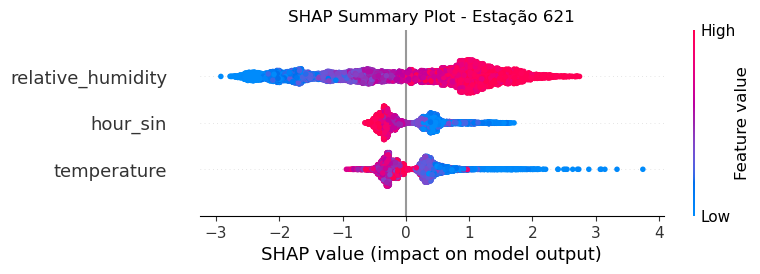

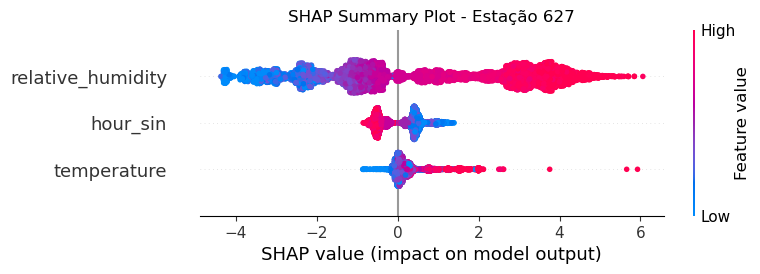

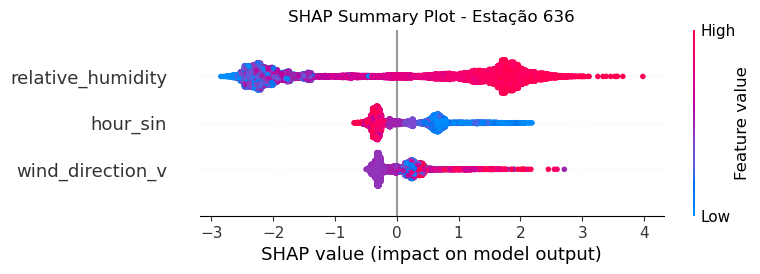

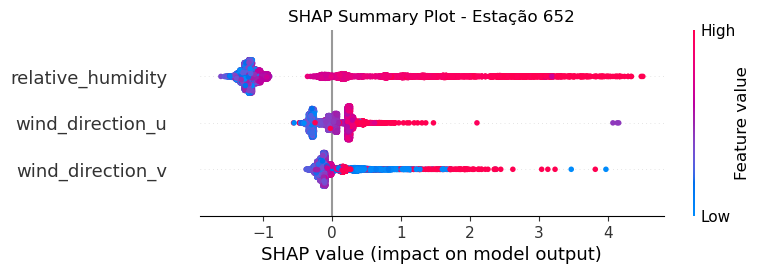

In [199]:
import shap
import matplotlib.pyplot as plt

# Suponha que você tenha os seguintes conjuntos de dados
shap_values_list = [shap_values602, shap_values621, shap_values627, shap_values636, shap_values652]
X_test_list = [X_602test, X_621test, X_627test, X_636test, X_652test]

# Suponha que você queira exibir no máximo 3 features no gráfico de resumo
max_display = 3

# Criar o gráfico de resumo para múltiplos conjuntos de valores SHAP
for shap_values, X_test, dataset_name in zip(shap_values_list, X_test_list, ["602", "621", "627", "636", "652"]):
    shap.summary_plot(shap_values, X_test, max_display=max_display, show=False)
    plt.title(f"SHAP Summary Plot - Estação {dataset_name}")
    plt.show()


# 5 Redução de dimensionalidade

### A652

In [328]:
import numpy as np
import pandas as pd
import pickle
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from umap import UMAP
import matplotlib.pyplot as plt
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.metrics import accuracy_score

In [329]:
# Importando o Dataset
file = open('A652.pickle' , 'rb')
(X_train , y_train , X_val , y_val , X_test , y_test) = pickle.load(file)
print(f"Shapes: ", X_train.shape , X_val.shape , X_test.shape, y_train.shape , y_val.shape , y_test.shape)

Shapes:  (10012, 24) (2506, 24) (9582, 24) (10012, 1) (2506, 1) (9582, 1)


### Concatenando os dados de treino com dados de validação

In [330]:
X_train_combined = np.concatenate((X_train, X_val), axis=0)
y_train_combined = np.concatenate((y_train, y_val), axis=0)

print("X_train_combined:", X_train_combined.shape)
print("y_train_combined:", y_train_combined.shape)

X_train_combined: (12518, 24)
y_train_combined: (12518, 1)


### Padronizando os dados

In [331]:
# Padronizar os dados (importante para métodos que dependem de distâncias)
scaler = StandardScaler()
X_train_combined_sc = scaler.fit_transform(X_train_combined)
X_test_sc = scaler.fit_transform(X_test)

Text(0, 0.5, 'cumulative explained variance')

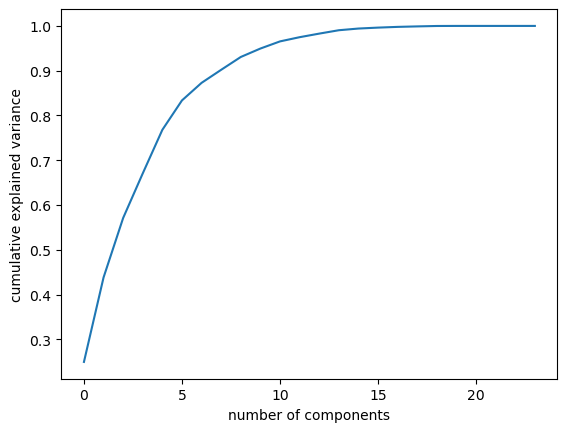

In [332]:
import numpy as np
pca = PCA().fit(X_train_combined_sc.data)
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('number of components')
plt.ylabel('cumulative explained variance')

Text(0, 0.5, 'cumulative explained variance')

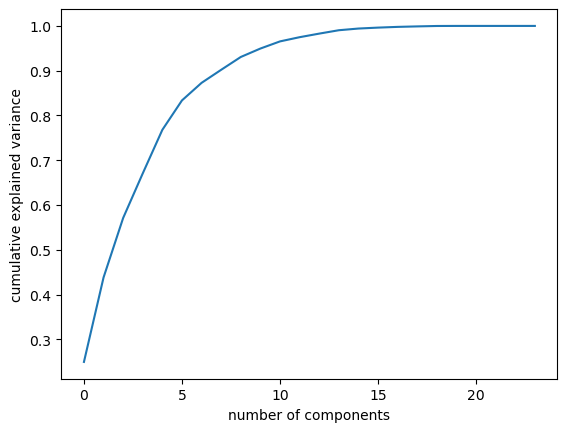

In [333]:
import numpy as np
umap = UMAP().fit(X_train_combined_sc.data)
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('number of components')
plt.ylabel('cumulative explained variance')

Text(0, 0.5, 'cumulative explained variance')

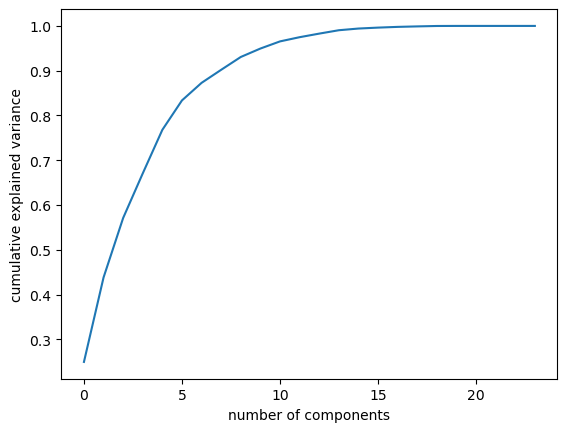

In [334]:
import numpy as np
tsne = TSNE().fit(X_train_combined_sc.data)
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('number of components')
plt.ylabel('cumulative explained variance')

In [335]:
pca.n_components_

24

In [336]:
import numpy as np
from sklearn.decomposition import PCA
pca = PCA(n_components=10)
pca.fit(X_train_combined)
PCA(n_components=10)
print(pca.explained_variance_ratio_)

[0.39752414 0.37469502 0.09636396 0.05377743 0.03634281 0.01436318
 0.00895538 0.00369445 0.00332343 0.00201902]


### Com 3 componentes, temos 85% de explicação das variáveis

In [337]:
import numpy as np
from sklearn.decomposition import PCA
pca = PCA(n_components=3)
pca.fit(X_train_combined)
PCA(n_components=3)
print(pca.explained_variance_ratio_)

[0.39752414 0.37469502 0.09636396]


### Utilizando métodos PCA, T-SNE e UMAP para redução de dimensionalidades com 3 componentes

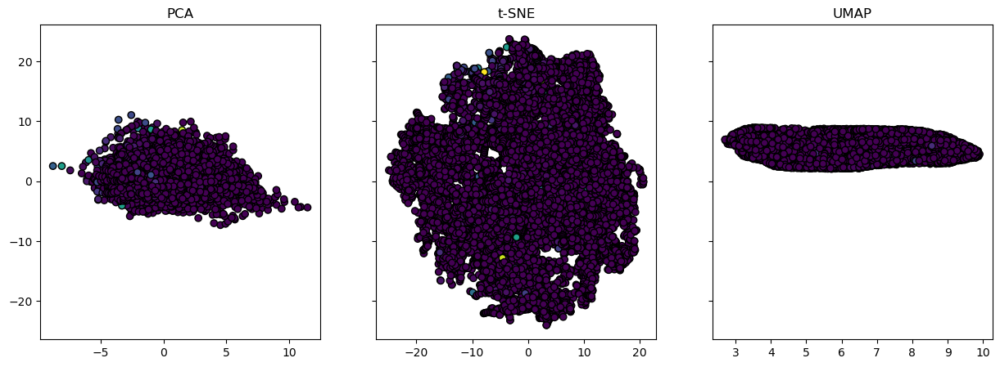

In [79]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from umap import UMAP
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.metrics import accuracy_score

# Aplicar PCA com 3 componentes
pca = PCA(n_components=3)
X_pca = pca.fit_transform(X_train_combined_sc)
X_tpca = pca.fit_transform(X_test_sc)


# Aplicar t-SNE com 3 componentes
tsne = TSNE(n_components=3, random_state= None)
X_tsne = tsne.fit_transform(X_train_combined_sc)
X_ttsne = tsne.fit_transform(X_test_sc)

# Aplicar UMAP com 3 componentes
umap = UMAP(n_components=3, random_state= None)
X_umap = umap.fit_transform(X_train_combined_sc)
X_tumap = umap.fit_transform(X_test_sc)

# Visualizar os resultados
fig, axes = plt.subplots(1, 3, figsize=(15, 5), sharey=True)

# Plotar PCA
axes[0].scatter(X_pca[:, 0], X_pca[:, 1], c=y_train_combined, cmap='viridis', edgecolor='k')
axes[0].set_title('PCA')

# Plotar t-SNE
axes[1].scatter(X_tsne[:, 0], X_tsne[:, 1], c=y_train_combined, cmap='viridis', edgecolor='k')
axes[1].set_title('t-SNE')

# Plotar UMAP
axes[2].scatter(X_umap[:, 0], X_umap[:, 1], c=y_train_combined, cmap='viridis', edgecolor='k')
axes[2].set_title('UMAP')

plt.show()


### Observando o gráfico apresentado acima, notamos que existe uma correlação positiva entre as duas variáveis: valores maiores de uma das variáveis correspondem a valores maiores da outra, e vice-versa. Apenas pelo método T-SNE é mais disperso. 

### Abaixo, podemos observar esse comportamento inspecionando a matriz de covariância empírica.

### PCA

In [80]:
from sklearn.covariance import EmpiricalCovariance
cov = EmpiricalCovariance().fit(X_train_pca)
print(cov.covariance_)

[[ 5.98842027e+00 -9.74030464e-16]
 [-9.74030464e-16  4.52746065e+00]]


### T-SNE

In [81]:
from sklearn.covariance import EmpiricalCovariance
cov = EmpiricalCovariance().fit(X_train_tsne)
print(cov.covariance_)

[[1640.41107122   15.95733459]
 [  15.95733459 1448.28628217]]


### UMAP

In [82]:
from sklearn.covariance import EmpiricalCovariance
cov = EmpiricalCovariance().fit(X_train_umap)
print(cov.covariance_)

[[ 7.73879739 -0.23959051]
 [-0.23959051  5.46887386]]


In [83]:
print(f"Shapes: ", X_pca.shape , X_tsne.shape , y_train.shape , y_val.shape , y_test.shape)

Shapes:  (12518, 3) (12518, 3) (10012, 1) (2506, 1) (9582, 1)


### Discretização

In [84]:
# Converta as séries de dados para arrays unidimensionais

y_train_array = np.squeeze(np.asarray(y_train))
y_val_array = np.squeeze(np.asarray(y_val))
y_test_array = np.squeeze(np.asarray(y_test))

# Defina os limites para discretização
bins = [float('-inf'), 0, 5, 25, 50, float('inf')]

# Defina os rótulos para cada categoria
labels = ['NONE', 'WEAK', 'MODERATE', 'STRONG', 'EXTREME']
#labels = ['0', '1', '2', '3', '4']

# Discretize as séries de dados
y_train_discretized = pd.cut(y_train_array, bins=bins, labels=labels, right=False)
y_val_discretized = pd.cut(y_val_array, bins=bins, labels=labels, right=False)
y_test_discretized = pd.cut(y_test_array, bins=bins, labels=labels, right=False)

In [85]:
# Agora, y_train_discretized, y_val_discretized e y_test_discretized contêm as classes discretizadas

print(y_train_discretized.categories)

Index(['NONE', 'WEAK', 'MODERATE', 'STRONG', 'EXTREME'], dtype='object')


In [86]:
y_train_comb_discretized = np.concatenate((y_train_discretized, y_val_discretized), axis=0)

In [90]:
print(f"Shapes: ", X_pca.shape , X_tsne.shape , X_umap.shape, X_tpca.shape,  X_ttsne.shape,  X_tumap.shape, y_train_comb_discretized.shape, y_test_discretized.shape)

Shapes:  (12518, 3) (12518, 3) (12518, 3) (9582, 3) (9582, 3) (9582, 3) (12518,) (9582, 1)


### Criando os modelos com a dimensionalidade reduzida

In [42]:
# Escolha a dimensionalidade reduzida desejada (X_pca, X_tsne, ou X_umap)
print('X_pca', 'X_tsne', 'X_umap')

X_pca X_tsne X_umap


In [93]:
# Criar e treinar o modelo GradientBoostingClassifier
gb_classifier_pca = GradientBoostingClassifier(random_state=42)
gb_classifier_tsne = GradientBoostingClassifier(random_state=42)
gb_classifier_umap = GradientBoostingClassifier(random_state=42)
gb_classifier_base = GradientBoostingClassifier(random_state=42)

gb_classifier_pca.fit(X_pca, y_train_comb_discretized)
gb_classifier_tsne.fit(X_tsne, y_train_comb_discretized)
gb_classifier_umap.fit(X_umap, y_train_comb_discretized)
gb_classifier_base.fit(X_train_combined, y_train_comb_discretized)

# Fazer previsões no conjunto de teste
y_pred_pca = gb_classifier_pca.predict(X_tpca)
y_pred_tsne = gb_classifier_tsne.predict(X_ttsne)
y_pred_umap = gb_classifier_umap.predict(X_tumap)
y_pred_base = gb_classifier_base.predict(X_test)

# Avaliar o modelo
accuracy_pca = accuracy_score(y_test_discretized, y_pred_pca)
print("Acurácia do modelo com dimensionalidade PCA:", accuracy_pca)
accuracy_tsne = accuracy_score(y_test_discretized, y_pred_tsne)
print("Acurácia do modelo com dimensionalidade TSNE:", accuracy_tsne)
accuracy_umap = accuracy_score(y_test_discretized, y_pred_umap)
print("Acurácia do modelo com dimensionalidade PCA:", accuracy_umap)
accuracy_base = accuracy_score(y_test_discretized, y_pred_base)
print("Acurácia do modelo com BASE:", accuracy_base)

Acurácia do modelo com dimensionalidade PCA: 0.9903986641619703
Acurácia do modelo com dimensionalidade TSNE: 0.9853892715508245
Acurácia do modelo com dimensionalidade PCA: 0.9885201419327907
Acurácia do modelo com BASE: 0.992068461699019


# 6 Agrupamento

### A652

In [338]:
import pickle
import numpy as np
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score, make_scorer
from sklearn.model_selection import GridSearchCV
from sklearn.preprocessing import StandardScaler
import numpy as np
from sklearn.cluster import KMeans
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import warnings
from sklearn.tree import _tree
from sklearn import tree
warnings.filterwarnings("ignore")
from sklearn.cluster import DBSCAN


# Importando o Dataset
file = open('A652.pickle' , 'rb')
(X_train , y_train , X_val , y_val , X_test , y_test) = pickle.load(file)
print(f"Shapes: ", X_train.shape , X_val.shape , X_test.shape, y_train.shape , y_val.shape , y_test.shape)

Shapes:  (10012, 24) (2506, 24) (9582, 24) (10012, 1) (2506, 1) (9582, 1)


In [339]:
X_train_combined = np.concatenate((X_train, X_val), axis=0)
y_train_combined = np.concatenate((y_train, y_val), axis=0)

In [340]:
print(f"Shapes: ", y_train_comb_discretized.shape , y_test_discretized.shape)

Shapes:  (12518,) (9582,)


### K-Means

### O K-Means é um algoritmo de agrupamento (clustering) que busca particionar um conjunto de dados em k clusters distintos. Cada cluster é representado por seu centróide, que é o ponto médio de todos os pontos no cluster. O objetivo do K-Means é atribuir cada ponto de dados ao cluster cujo centróide está mais próximo.

In [341]:
# Padronizar os dados (importante para K-Means)
scaler = StandardScaler()
X_train_combined_sc = scaler.fit_transform(X_train_combined) #ok
X_test_sc = scaler.fit_transform(X_test)


In [342]:
# Definir a faixa de parâmetros a serem testados
param_grid = {'n_clusters': [2,3,4,5,6,7]}

In [343]:
# Criar objeto KMeans
kmeans = KMeans(n_init=10)

# Criar uma função de pontuação Silhouette
silhouette_scorer = make_scorer(silhouette_score)

# Usar GridSearchCV com a métrica Silhouette
grid_search = GridSearchCV(kmeans, param_grid, cv=10, scoring=silhouette_scorer)
grid_search.fit(X_train_combined_sc)

GridSearchCV(cv=10, estimator=KMeans(n_init=10),
             param_grid={'n_clusters': [2, 3, 4, 5, 6, 7]},
             scoring=make_scorer(silhouette_score))

In [344]:
# Exibir os melhores parâmetros encontrados
print("Melhores parâmetros para K-Means:", grid_search.best_params_)

Melhores parâmetros para K-Means: {'n_clusters': 2}


In [345]:
best_kmeans = grid_search.best_estimator_

In [346]:
#clusterizando
best_kmeans.fit(X_train_combined_sc)

KMeans(n_clusters=2, n_init=10)

In [347]:
km_final = pd.DataFrame(X_train_combined_sc)
km_final['cluster'] = best_kmeans.labels_

In [348]:
alvo = ['cluster']

kmx = KM_final.select_dtypes('float').columns

In [349]:
X = km_final[kmx]
y_cluster = km_final[alvo]

In [350]:
X.shape, y_cluster.shape, X_test.shape

((12518, 24), (12518, 1), (9582, 24))

In [351]:
# Criar e treinar o modelo DecisionTreeClassifier
dt_classifier = DecisionTreeClassifier(random_state=42)
dt_classifier.fit(X, y_cluster)

DecisionTreeClassifier(random_state=42)

In [352]:
# Fazer previsões no conjunto de teste
y_pred = dt_classifier.predict(X_test)

In [353]:
text_representation = tree.export_text(dt_classifier)
print(text_representation)

|--- feature_8 <= 0.13
|   |--- feature_21 <= -0.53
|   |   |--- feature_10 <= 0.39
|   |   |   |--- feature_8 <= -0.58
|   |   |   |   |--- feature_19 <= -0.69
|   |   |   |   |   |--- feature_0 <= -0.51
|   |   |   |   |   |   |--- feature_4 <= 1.06
|   |   |   |   |   |   |   |--- feature_6 <= 0.19
|   |   |   |   |   |   |   |   |--- class: 0
|   |   |   |   |   |   |   |--- feature_6 >  0.19
|   |   |   |   |   |   |   |   |--- feature_12 <= 1.31
|   |   |   |   |   |   |   |   |   |--- class: 1
|   |   |   |   |   |   |   |   |--- feature_12 >  1.31
|   |   |   |   |   |   |   |   |   |--- class: 0
|   |   |   |   |   |   |--- feature_4 >  1.06
|   |   |   |   |   |   |   |--- feature_19 <= -2.11
|   |   |   |   |   |   |   |   |--- feature_9 <= 1.05
|   |   |   |   |   |   |   |   |   |--- class: 0
|   |   |   |   |   |   |   |   |--- feature_9 >  1.05
|   |   |   |   |   |   |   |   |   |--- class: 1
|   |   |   |   |   |   |   |--- feature_19 >  -2.11
|   |   |   |   |   |   |

In [354]:
text_representation = tree.export_text(dt_classifier, feature_names=list(X.columns))
print(text_representation)

|--- 8 <= 0.13
|   |--- 21 <= -0.53
|   |   |--- 10 <= 0.39
|   |   |   |--- 8 <= -0.58
|   |   |   |   |--- 19 <= -0.69
|   |   |   |   |   |--- 0 <= -0.51
|   |   |   |   |   |   |--- 4 <= 1.06
|   |   |   |   |   |   |   |--- 6 <= 0.19
|   |   |   |   |   |   |   |   |--- class: 0
|   |   |   |   |   |   |   |--- 6 >  0.19
|   |   |   |   |   |   |   |   |--- 12 <= 1.31
|   |   |   |   |   |   |   |   |   |--- class: 1
|   |   |   |   |   |   |   |   |--- 12 >  1.31
|   |   |   |   |   |   |   |   |   |--- class: 0
|   |   |   |   |   |   |--- 4 >  1.06
|   |   |   |   |   |   |   |--- 19 <= -2.11
|   |   |   |   |   |   |   |   |--- 9 <= 1.05
|   |   |   |   |   |   |   |   |   |--- class: 0
|   |   |   |   |   |   |   |   |--- 9 >  1.05
|   |   |   |   |   |   |   |   |   |--- class: 1
|   |   |   |   |   |   |   |--- 19 >  -2.11
|   |   |   |   |   |   |   |   |--- class: 0
|   |   |   |   |   |--- 0 >  -0.51
|   |   |   |   |   |   |--- 3 <= -0.58
|   |   |   |   |   |   |   |--

### DBSCAN

### O DBSCAN é um algoritmo de clustering baseado em densidade. Em vez de assumir que os clusters têm uma forma específica, o DBSCAN define clusters como regiões densas de pontos separadas por regiões menos densas. 

In [355]:
import numpy as np
from sklearn.cluster import DBSCAN
from sklearn.metrics import silhouette_score, make_scorer
from sklearn.model_selection import GridSearchCV
from sklearn.preprocessing import StandardScaler

# Padronizar os dados (importante para DBSCAN)
scaler = StandardScaler()
X_train_combined_sc = scaler.fit_transform(X_train_combined)
X_test_sc = scaler.fit_transform(X_test)

# Definir a faixa de parâmetros a serem testados
param_grid = {'eps': [0.1, 0.3, 0.5, 0.7, 1.0, 2.0],
              'min_samples': [5, 10, 15, 20, 30, 50]}

# Criar objeto DBSCAN
dbscan = DBSCAN()

# Criar uma função de pontuação Silhouette
silhouette_scorer = make_scorer(silhouette_score)

# Usar GridSearchCV com a métrica Silhouette
grid_search = GridSearchCV(dbscan, param_grid, scoring=silhouette_scorer)
grid_search.fit(X_train_combined)

GridSearchCV(estimator=DBSCAN(),
             param_grid={'eps': [0.1, 0.3, 0.5, 0.7, 1.0, 2.0],
                         'min_samples': [5, 10, 15, 20, 30, 50]},
             scoring=make_scorer(silhouette_score))

In [356]:
print("Melhores parâmetros para DBSCAN:", grid_search.best_params_)

Melhores parâmetros para DBSCAN: {'eps': 0.1, 'min_samples': 5}


In [357]:
best_dbscan = grid_search.best_estimator_

In [358]:
#clusterizando
best_dbscan.fit(X_train_combined_sc)

DBSCAN(eps=0.1)

In [359]:
dbscan_final = pd.DataFrame(X_train_combined_sc)
dbscan_final['cluster'] = best_dbscan.labels_

In [360]:
alvo2 = ['cluster']

dbscanx = dbscan_final.select_dtypes('float').columns

In [362]:
X_db = dbscan_final[kmx]
y_clusterdb = dbscan_final[alvo2]

In [363]:
X_db.shape, y_clusterdb.shape, X_test.shape

((12518, 24), (12518, 1), (9582, 24))

In [364]:
# Criar e treinar o modelo DecisionTreeClassifier
dt_classifier_db = DecisionTreeClassifier(random_state=42)
dt_classifier_db.fit(X_db, y_clusterdb)

DecisionTreeClassifier(random_state=42)

In [365]:
# Fazer previsões no conjunto de teste
y_pred_db = dt_classifier_db.predict(X_test)

In [366]:
text_representation = tree.export_text(dt_classifier_db)
print(text_representation)

|--- class: 0



In [367]:
text_representation = tree.export_text(dt_classifier_db, feature_names=list(X.columns))
print(text_representation)

|--- class: 0



### Ambos os algoritmos têm suas vantagens e desvantagens, e a escolha entre eles muitas vezes depende da natureza dos dados e dos objetivos do problema. O K-Means é eficaz para clusters globulares e em grande escala, enquanto o DBSCAN é mais flexível em relação à forma dos clusters e lida bem com dados de densidades variáveis.